## Loading kaggle dataset & Setup

In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("pkdarabi/bone-break-classification-image-dataset")

print("Path to dataset files:", path)

100%|██████████| 28.4M/28.4M [00:00<00:00, 90.2MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/pkdarabi/bone-break-classification-image-dataset/versions/4


In [2]:
import shutil
from pathlib import Path

dest = Path("./data/bone-break")  # your project path
dest.mkdir(parents=True, exist_ok=True)
for item in Path(path).iterdir():
    tgt = dest / item.name
    if item.is_dir():
        shutil.copytree(item, tgt, dirs_exist_ok=True)
    else:
        shutil.copy2(item, tgt)
print("Copied to:", dest)

Copied to: data/bone-break


In [3]:
!pwd

/content


In [4]:
from pathlib import Path
import json

# === Point this to the folder that CONTAINS all class folders ===
CWD = Path.cwd()  # '/content' in Colab
ROOT = CWD / "data" / "bone-break" / "Bone Break Classification" / "Bone Break Classification"

IMG_EXTS = {".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".gif"}

def has_images(p: Path) -> bool:
    if not p.exists() or not p.is_dir():
        return False
    for q in p.rglob("*"):
        if q.is_file() and q.suffix.lower() in IMG_EXTS:
            return True
    return False

def derive_class_dirs(root: Path):
    """
    Return a sorted list of (class_name, class_dir) pairs.
    class_dir is the top-level folder representing the class.
    """
    class_pairs = []
    for child in sorted([d for d in root.iterdir() if d.is_dir()], key=lambda x: x.name.lower()):
        # Case 1: images are directly inside the child directory
        if has_images(child):
            class_pairs.append((child.name, child))
            continue

        # Case 2: images live under a Train/train folder inside the child
        train_dir = None
        for name in ("Train", "train"):
            cand = child / name
            if cand.is_dir() and has_images(cand):
                train_dir = cand
                break
        if train_dir is not None:
            class_pairs.append((child.name, child))

    # sanity check
    if not class_pairs:
        raise RuntimeError(f"No class folders with images found under: {root.resolve()}")

    return class_pairs

# ---- Run & summarize ----
class_dirs = derive_class_dirs(ROOT)
class_names = [name for name, _ in class_dirs]
class_to_idx = {name: i for i, name in enumerate(class_names)}

print("Discovered classes:")
for i, name in enumerate(class_names):
    print(f"[{i}] {name}")

# Optional: save mapping for later use
OUT = ROOT / "class_to_idx.json"
with OUT.open("w") as f:
    json.dump(class_to_idx, f, indent=2)
print(f"\nSaved class_to_idx to: {OUT}")

classes = sorted(class_names)

Discovered classes:
[0] Avulsion fracture
[1] Comminuted fracture
[2] Fracture Dislocation
[3] Greenstick fracture
[4] Hairline Fracture
[5] Impacted fracture
[6] Longitudinal fracture
[7] Oblique fracture
[8] Pathological fracture
[9] Spiral Fracture

Saved class_to_idx to: /content/data/bone-break/Bone Break Classification/Bone Break Classification/class_to_idx.json


Check runtime and GPU

In [5]:
!nvidia-smi -L || true
import torch, sys, os, pathlib, random
print("Torch:", torch.__version__, "CUDA:", torch.cuda.is_available())
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

GPU 0: Tesla T4 (UUID: GPU-32aebdf5-2ba8-7513-18c5-3cd8ebec2f81)
Torch: 2.8.0+cu126 CUDA: True


Install required packages

In [6]:
# core
!pip -q install --upgrade pip
!pip -q install legrad_torch open_clip_torch timm kagglehub pillow matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 23.1 MB/s eta 0:00:00


## Pretrained ViT with LeGrad (no finetuning)

Classes found: 10
  Avulsion fracture: 000002_png.rf.c3e00ebc2db78bc94e644c3f6605dad0.jpg
  Comminuted fracture: images94_jpg.rf.1be75680f0289a4d2bcc8d0c112a3453.jpg
  Fracture Dislocation: 0-_jumbo_jpeg.rf.29079abb47d5de12076aed66aea08064.jpg
  Greenstick fracture: 0-_jumbo_jpeg.rf.f83148ed2e6771e243f98f5595db6b9c.jpg
  Hairline Fracture: 0-_jumbo_jpeg.rf.d39588df830d194c0cda3b800664160b.jpg


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


Saved 10 overlays to: /content/legrad_vit_first_per_class


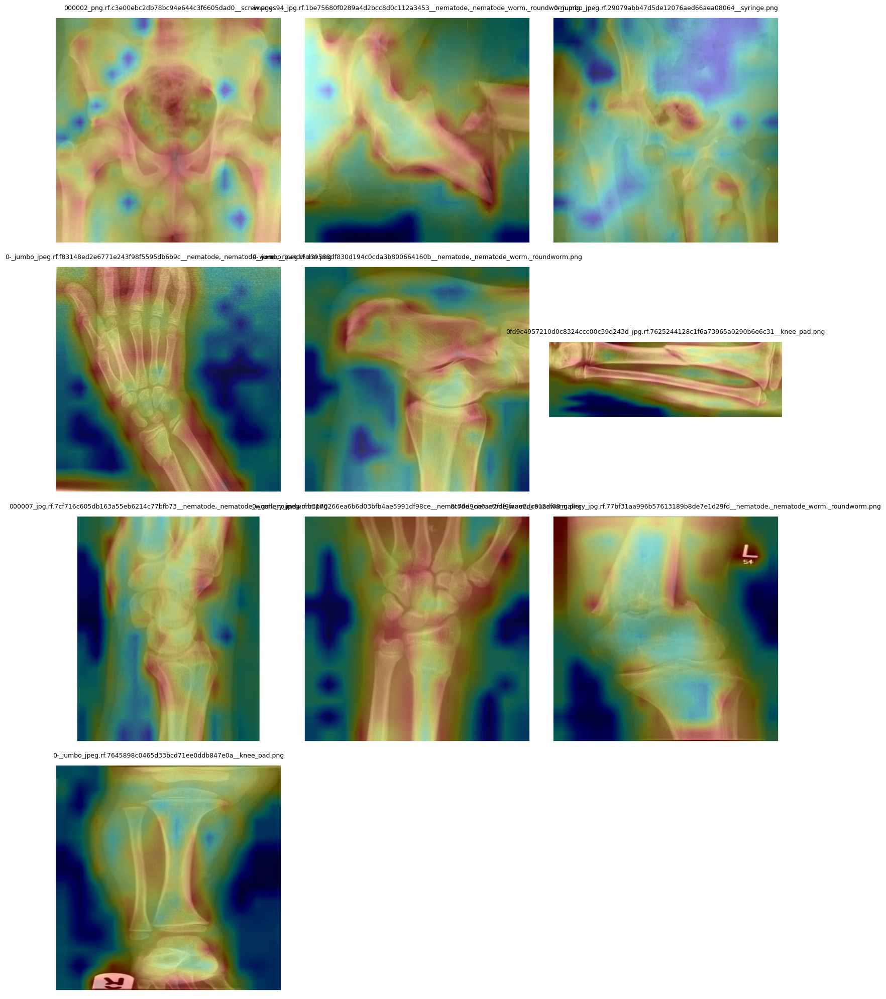

In [13]:
# === ViT + LeGrad (no text) | First image per class ===
# !pip install -q transformers timm pillow

import os, math
from pathlib import Path
from typing import List, Tuple, Dict

import torch
import torch.nn.functional as F
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from transformers import AutoImageProcessor, AutoModelForImageClassification

# ----------------------------
# Config
# ----------------------------
device = "cuda" if torch.cuda.is_available() else "cpu"
ROOT = Path("/content/data/bone-break/Bone Break Classification/Bone Break Classification")
OUT_DIR = Path("/content/legrad_vit_first_per_class")
OUT_DIR.mkdir(parents=True, exist_ok=True)

MODEL_ID = "google/vit-base-patch16-224"  # swap to your fine-tuned ViT if available
IMAGE_SIZE = 448                           # higher -> crisper heatmaps (more VRAM)
ALPHA = 0.35                               # overlay transparency

# ----------------------------
# Discover one image per class (first in sorted order)
# ----------------------------
IMG_EXTS = {".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".gif"}

def first_image_in_dir(d: Path) -> Path | None:
    imgs = sorted([p for p in d.rglob("*") if p.is_file() and p.suffix.lower() in IMG_EXTS],
                  key=lambda p: p.as_posix().lower())
    return imgs[0] if imgs else None

def list_first_images_per_class(root: Path) -> Dict[str, Path]:
    if not root.exists():
        raise FileNotFoundError(f"Root not found: {root}")
    out = {}
    class_dirs = sorted([d for d in root.iterdir() if d.is_dir()], key=lambda p: p.name.lower())
    for cdir in class_dirs:
        # Prefer Test/ or test/ subdir when available
        tdir = None
        for n in ("Test", "test"):
            cand = cdir / n
            if cand.is_dir():
                tdir = cand; break
        tdir = tdir or cdir
        img = first_image_in_dir(tdir)
        if img is not None:
            out[cdir.name] = img
    return out

per_class = list_first_images_per_class(ROOT)
print(f"Classes found: {len(per_class)}")
for cls, path in list(per_class.items())[:5]:
    print(f"  {cls}: {path.name}")
if not per_class:
    raise RuntimeError("No images found. Check ROOT path and folder structure.")

# ----------------------------
# Load model (returns attentions)
# ----------------------------
model = AutoModelForImageClassification.from_pretrained(MODEL_ID, output_attentions=True).to(device).eval()
processor = AutoImageProcessor.from_pretrained(MODEL_ID)
ID2LABEL = getattr(model.config, "id2label", None)

# ----------------------------
# LeGrad (no-text) core
# ----------------------------
def compute_legrad_vit(image_pil: Image.Image, target_index: int | None = None, image_size: int = 448) -> Tuple[np.ndarray, int]:
    """
    Compute LeGrad heatmap for a ViT classifier:
      - Backprop from chosen class logit to attention maps at each layer
      - Keep positive grads, average across heads, sum across layers
      - Remove [CLS], pool to per-patch scores, reshape to grid, upsample
    Returns: (heatmap [H,W] in [0,1], target_class_index)
    """
    # High-res preprocess for crisper maps
    img_resized = image_pil.resize((image_size, image_size), Image.BILINEAR)
    inputs = processor(images=img_resized, return_tensors="pt")
    pixel_values = inputs["pixel_values"].to(device)
    pixel_values.requires_grad_(True)

    # Forward with attentions
    out = model(pixel_values=pixel_values, output_attentions=True)
    logits = out.logits  # [1, C]
    if target_index is None:
        target_index = int(logits.argmax(dim=-1).item())

    # Retain grads on attention tensors
    for a in out.attentions:
        a.retain_grad()

    # Backprop from chosen logit
    loss = logits[0, target_index]
    model.zero_grad(set_to_none=True)
    loss.backward(retain_graph=False)

    # Aggregate positive attention grads across heads & layers
    grads_per_layer = []
    for a in out.attentions:             # each: [1, heads, T, T]
        g = a.grad
        if g is None:
            continue
        g = F.relu(g).mean(dim=1)        # -> [1, T, T]
        grads_per_layer.append(g[0])     # -> [T, T]

    if not grads_per_layer:
        raise RuntimeError("No attention gradients captured. Ensure output_attentions=True and no torch.no_grad().")

    G = torch.stack(grads_per_layer, dim=0).sum(dim=0)  # [T, T]

    # Remove [CLS] (token 0)
    G = G[1:, 1:]                        # [N_patches, N_patches]
    patch_scores = F.relu(G.sum(dim=0))  # pool queries -> [N_patches]
    patch_scores = patch_scores / (patch_scores.max() + 1e-8)

    side = int(np.sqrt(patch_scores.numel()))
    heat = patch_scores.reshape(side, side).detach().cpu().numpy().astype(np.float32)

    # Upsample back to IMAGE_SIZE for overlay
    heat_img = Image.fromarray((heat * 255).astype(np.uint8)).resize((image_size, image_size), Image.BILINEAR)
    heat = np.array(heat_img, dtype=np.float32) / 255.0
    return heat, target_index

def save_overlay(pil_img: Image.Image, heat: np.ndarray, out_path: Path, alpha: float = 0.35):
    W, H = pil_img.size
    hm = Image.fromarray((heat * 255).astype(np.uint8)).resize((W, H), Image.BILINEAR)
    plt.figure(figsize=(6, 6))
    plt.imshow(pil_img)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off")
    plt.tight_layout()
    out_path.parent.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=150, bbox_inches="tight")
    plt.close()

# ----------------------------
# Run for first image per class
# ----------------------------
outputs: List[Tuple[Path, str]] = []
for cls_name, img_path in per_class.items():
    raw = Image.open(img_path).convert("RGB")
    heat, cls_idx = compute_legrad_vit(raw, target_index=None, image_size=IMAGE_SIZE)
    # Choose a readable label if available (for ImageNet models)
    label = ID2LABEL[cls_idx] if (ID2LABEL and cls_idx in ID2LABEL) else f"class_{cls_idx}"
    out_png = OUT_DIR / f"{Path(img_path).stem}__{label.replace(' ', '_')}.png"
    save_overlay(raw, heat, out_png, alpha=ALPHA)
    outputs.append((out_png, f"{cls_name} → {label}"))

print(f"Saved {len(outputs)} overlays to: {OUT_DIR}")

# ----------------------------
# Display grid
# ----------------------------
cols = 3
rows = math.ceil(len(outputs) / cols)
plt.figure(figsize=(5*cols, 5*rows))
for i, (op, lbl) in enumerate(outputs, start=1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(Path(op).name, fontsize=9)
    ax.set_xlabel(lbl, fontsize=8)
    ax.axis("off")
plt.tight_layout()
plt.show()

In [15]:
# ===== Add this below your current code to get accuracy for the pretrained ViT =====
from torch.utils.data import Dataset, DataLoader

# --- 1) Build train/test file lists (by folders) ---
def first_existing(*paths: Path) -> Path | None:
    for p in paths:
        if p is not None and p.exists():
            return p
    return None

IMG_EXTS = {".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".gif"}

def iter_images(d: Path):
    return [p for p in d.rglob("*") if p.is_file() and p.suffix.lower() in IMG_EXTS]

class_dirs = sorted([d for d in ROOT.iterdir() if d.is_dir()], key=lambda p: p.name.lower())
classes = [d.name for d in class_dirs]
label2id = {c:i for i,c in enumerate(classes)}
id2label = {i:c for c,i in label2id.items()}
num_labels = len(classes)
print(f"Detected {num_labels} classes for eval:", classes)

train_files, test_files = [], []
for cdir in class_dirs:
    train_dir = first_existing(cdir / "Train", cdir / "train")
    test_dir  = first_existing(cdir / "Test",  cdir / "test", cdir)  # fallback to top-level if no Test/
    if train_dir:
        train_files += [(p, label2id[cdir.name]) for p in iter_images(train_dir)]
    if test_dir:
        test_files  += [(p, label2id[cdir.name]) for p in iter_images(test_dir)]

print(f"[Eval setup] Train imgs: {len(train_files)} | Test imgs: {len(test_files)}")
assert len(train_files) and len(test_files), "Need both Train/ and Test/ images for accuracy."

# --- 2) Eval transforms at native model size (224) ---
processor_224 = AutoImageProcessor.from_pretrained(MODEL_ID, use_fast=True)

class ImgDS(Dataset):
    def __init__(self, pairs, proc):
        self.pairs, self.proc = pairs, proc
    def __len__(self): return len(self.pairs)
    def __getitem__(self, i):
        p, y = self.pairs[i]
        img = Image.open(p).convert("RGB")
        x = self.proc(images=img, return_tensors="pt")["pixel_values"].squeeze(0)
        return x, y, str(p)

def mk_loader(pairs, bs=64, shuffle=False):
    return DataLoader(ImgDS(pairs, processor_224), batch_size=bs, shuffle=shuffle,
                      num_workers=2, pin_memory=(device=="cuda"))

train_loader_224 = mk_loader(train_files, bs=32, shuffle=False)
test_loader_224  = mk_loader(test_files,  bs=64, shuffle=False)

# --- 3) Frozen ViT features (encoder CLS after layernorm) ---
@torch.no_grad()
def vit_features(x_batch: torch.Tensor) -> torch.Tensor:
    x_batch = x_batch.to(device)
    enc = model.vit(pixel_values=x_batch, output_attentions=False)   # encoder only
    cls = enc.last_hidden_state[:, 0]                                # [B, hidden]

    # Use the correct LayerNorm:
    ln = getattr(model, "layernorm", None)
    if ln is None:
        ln = getattr(model.vit, "layernorm", None)
    if ln is not None:
        cls = ln(cls)                                                # match what the head expects

    feats = F.normalize(cls, dim=-1)                                 # cosine-friendly features
    return feats

# --- 4) Build class prototypes from Train features (nearest-centroid) ---
protos = torch.zeros((num_labels, model.config.hidden_size), device=device)
counts = torch.zeros((num_labels,), device=device)
with torch.no_grad():
    for xb, yb, _ in train_loader_224:
        feats = vit_features(xb)  # [B, D]
        yb = yb.to(device)
        for c in range(num_labels):
            mask = (yb == c)
            if mask.any():
                protos[c] += feats[mask].sum(dim=0)
                counts[c] += mask.sum()
protos = protos / counts.clamp_min(1.0).unsqueeze(1)
protos = F.normalize(protos, dim=-1)  # [C, D]

# --- 5) eval_model utility + getter for logits ---
@torch.no_grad()
def eval_model(get_logits_fn, loader):
    ys, ps = [], []
    for x, y, _ in loader:
        x = x.to(device)
        logits = get_logits_fn(x)        # [B, C]
        pred = logits.argmax(1).cpu()
        ys.append(y)
        ps.append(pred)
    y_true = torch.cat(ys).numpy()
    y_pred = torch.cat(ps).numpy()
    acc = (y_true == y_pred).mean()
    return acc, y_true, y_pred

def get_logits_nc(x: torch.Tensor) -> torch.Tensor:
    """
    Nearest-centroid 'logits' = cosine similarities to class prototypes.
    """
    feats = vit_features(x)          # [B, D]
    return feats @ protos.T          # [B, C]

# --- 6) Run accuracy for the PRETRAINED (frozen) ViT with nearest-centroid head ---
nc_acc, y_true, y_pred = eval_model(get_logits_nc, test_loader_224)
print(f"[Pretrained ViT (frozen) + Nearest-Centroid] Test Accuracy: {nc_acc:.3f}")

# (Optional) per-class accuracy
import numpy as np
per_class_acc = []
for c in range(num_labels):
    idx = np.where(y_true == c)[0]
    if len(idx):
        per_class_acc.append((id2label[c], (y_pred[idx] == y_true[idx]).mean(), len(idx)))
print("Per-class accuracy:", [(name, f"{acc:.3f}", n) for name, acc, n in per_class_acc])


Detected 10 classes for eval: ['Avulsion fracture', 'Comminuted fracture', 'Fracture Dislocation', 'Greenstick fracture', 'Hairline Fracture', 'Impacted fracture', 'Longitudinal fracture', 'Oblique fracture', 'Pathological fracture', 'Spiral Fracture']
[Eval setup] Train imgs: 989 | Test imgs: 140
[Pretrained ViT (frozen) + Nearest-Centroid] Test Accuracy: 0.221
Per-class accuracy: [('Avulsion fracture', '0.500', 14), ('Comminuted fracture', '0.143', 14), ('Fracture Dislocation', '0.158', 19), ('Greenstick fracture', '0.500', 16), ('Hairline Fracture', '0.000', 10), ('Impacted fracture', '0.111', 9), ('Longitudinal fracture', '0.083', 12), ('Oblique fracture', '0.125', 16), ('Pathological fracture', '0.222', 18), ('Spiral Fracture', '0.250', 12)]


## Pretrained ViT + Linear Probe with LeGrad

In [21]:
# ==== Linear Probe on Frozen ViT (PyTorch) ====
# Requires: classes (List[str]), train_files/test_files [(Path, label_id)],
# device, ROOT, and torch/torchvision/transformers installed.

import torch, torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
from transformers import AutoImageProcessor, ViTModel
from PIL import Image
import numpy as np
from collections import defaultdict
from pathlib import Path

# ---------- Config ----------
MODEL_ID = "google/vit-base-patch16-224"
BATCH = 32
EPOCHS = 10
LR = 1e-3
WEIGHT_DECAY = 0.01
TRAIN_SIZE = 224  # must match ViT's default to avoid size mismatch
use_amp = (device == "cuda")

num_labels = len(classes)
id2label = {i: c for i, c in enumerate(classes)}

# ---------- Datasets & tfms (no heavy augs; keep it “linear-probe simple”) ----------
processor = AutoImageProcessor.from_pretrained(MODEL_ID, use_fast=True)
mean = getattr(processor, "image_mean", [0.5, 0.5, 0.5])
std  = getattr(processor, "image_std",  [0.5, 0.5, 0.5])

eval_tfms = T.Compose([
    T.Resize(int(TRAIN_SIZE * 1.10)),
    T.CenterCrop(TRAIN_SIZE),
    T.ToTensor(),
    T.Normalize(mean=mean, std=std),
])

class ImgDataset(Dataset):
    def __init__(self, pairs, transform):
        self.pairs, self.transform = pairs, transform
    def __len__(self): return len(self.pairs)
    def __getitem__(self, i):
        path, y = self.pairs[i]
        img = Image.open(path).convert("RGB")
        x = self.transform(img)
        return x, y

train_ds = ImgDataset(train_files, eval_tfms)
test_ds  = ImgDataset(test_files,  eval_tfms)

train_loader = DataLoader(train_ds, batch_size=BATCH, shuffle=True,  num_workers=2, pin_memory=use_amp)
test_loader  = DataLoader(test_ds,  batch_size=BATCH, shuffle=False, num_workers=2, pin_memory=use_amp)

# ---------- Frozen ViT backbone ----------
vit = ViTModel.from_pretrained(MODEL_ID).to(device).eval()
for p in vit.parameters():
    p.requires_grad = False
feat_dim = vit.config.hidden_size  # 768 for base

# ---------- Linear head ----------
head = nn.Linear(feat_dim, num_labels).to(device)
optimizer = torch.optim.AdamW(head.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
scaler = torch.amp.GradScaler(enabled=use_amp)

# ---------- Helpers ----------
@torch.no_grad()
def extract_cls(vit_model, x):
    # ViTModel returns last_hidden_state [B, T, D]; CLS is token 0
    out = vit_model(x)
    cls = out.last_hidden_state[:, 0, :]  # [B, D]
    return cls

def run_epoch_linear(loader, train: bool):
    head.train(train)
    total=correct=0; loss_sum=0.0
    for xb, yb in loader:
        xb, yb = xb.to(device, non_blocking=use_amp), yb.to(device, non_blocking=use_amp)
        if train: optimizer.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type="cuda", dtype=torch.float16, enabled=use_amp):
            with torch.no_grad():  # backbone frozen
                feats = extract_cls(vit, xb)  # [B, D]
            logits = head(feats)             # [B, C]
            loss = F.cross_entropy(logits, yb)
        if train:
            scaler.scale(loss).backward()
            scaler.step(optimizer); scaler.update()
        pred = logits.argmax(-1)
        correct += (pred == yb).sum().item()
        total += yb.numel()
        loss_sum += float(loss) * yb.numel()
    return loss_sum/max(total,1), correct/max(total,1)

@torch.no_grad()
def evaluate_full(loader):
    head.eval()
    total=correct=0; top3=0
    # confusion matrix
    cm = torch.zeros(num_labels, num_labels, dtype=torch.long)
    per_cls_hits = defaultdict(int); per_cls_cnt = defaultdict(int)

    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        feats = extract_cls(vit, xb)
        logits = head(feats)
        probs = logits.softmax(-1)
        pred = probs.argmax(-1)
        total += yb.numel()
        correct += (pred == yb).sum().item()

        topk = probs.topk(k=min(3, num_labels), dim=-1).indices
        top3 += (topk == yb.unsqueeze(1)).any(dim=1).sum().item()

        # update cm and per-class
        for t, p in zip(yb.view(-1), pred.view(-1)):
            cm[t.long(), p.long()] += 1
            per_cls_cnt[int(t)] += 1
            if t == p: per_cls_hits[int(t)] += 1

    top1 = correct / max(total,1)
    top3_acc = top3 / max(total,1)
    per_class = [(id2label[i], f"{(per_cls_hits[i]/max(per_cls_cnt[i],1)):.3f}", per_cls_cnt[i]) for i in range(num_labels)]
    return top1, top3_acc, cm, per_class

# ---------- Train linear head ----------
for epoch in range(1, EPOCHS+1):
    tr_loss, tr_acc = run_epoch_linear(train_loader, train=True)
    te_top1, te_top3, _, _ = evaluate_full(test_loader)
    print(f"[LinearProbe] Epoch {epoch:02d} | train_loss={tr_loss:.4f} acc={tr_acc:.3f} | test@1={te_top1:.3f} test@3={te_top3:.3f}")

# ---------- Final eval & print per-class + confusion matrix ----------
top1, top3, cm, per_class = evaluate_full(test_loader)
print(f"\n[LinearProbe] Final Test top1={top1:.3f} top3={top3:.3f}")
print("Per-class accuracy:")
for name, acc, n in per_class:
    print(f"  - {name:<24} acc={acc} (n={n})")

print("\n[Test] Confusion matrix (rows=true, cols=pred):")
print(cm.cpu().numpy())


Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


[LinearProbe] Epoch 01 | train_loss=2.2272 acc=0.192 | test@1=0.236 test@3=0.471
[LinearProbe] Epoch 02 | train_loss=1.9912 acc=0.300 | test@1=0.257 test@3=0.529
[LinearProbe] Epoch 03 | train_loss=1.8711 acc=0.356 | test@1=0.250 test@3=0.629
[LinearProbe] Epoch 04 | train_loss=1.7382 acc=0.448 | test@1=0.286 test@3=0.600
[LinearProbe] Epoch 05 | train_loss=1.6481 acc=0.467 | test@1=0.300 test@3=0.650
[LinearProbe] Epoch 06 | train_loss=1.5839 acc=0.481 | test@1=0.314 test@3=0.607
[LinearProbe] Epoch 07 | train_loss=1.5254 acc=0.518 | test@1=0.314 test@3=0.629
[LinearProbe] Epoch 08 | train_loss=1.4616 acc=0.562 | test@1=0.364 test@3=0.686
[LinearProbe] Epoch 09 | train_loss=1.4086 acc=0.570 | test@1=0.371 test@3=0.621
[LinearProbe] Epoch 10 | train_loss=1.3670 acc=0.592 | test@1=0.336 test@3=0.693

[LinearProbe] Final Test top1=0.336 top3=0.693
Per-class accuracy:
  - Avulsion fracture        acc=0.429 (n=14)
  - Comminuted fracture      acc=0.571 (n=14)
  - Fracture Dislocation     a

Classes with a first test image: 10 / 10
Saved 10 overlays to: legrad_linearprobe


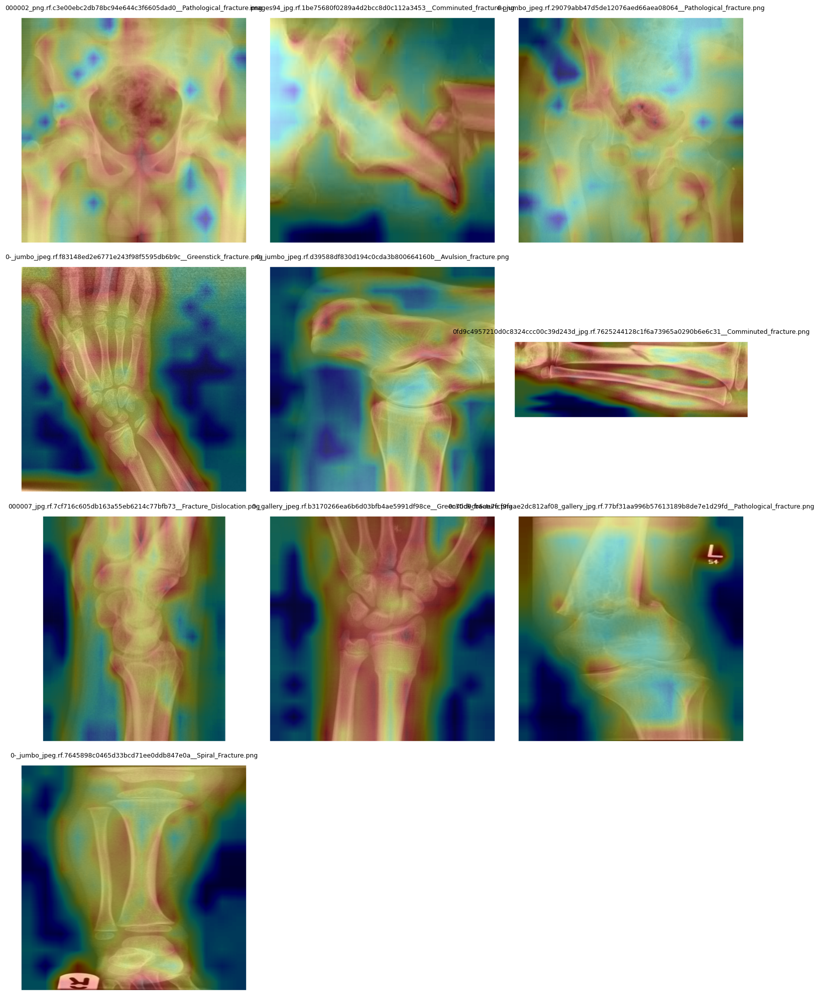

In [27]:
# -------- LeGrad overlays with Linear Probe (full code) --------
from typing import List, Tuple, Dict
from pathlib import Path
import math
import torch
import torch.nn.functional as F
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# ====== EDIT IF NEEDED ======
# Ensure these exist in your session:
# vit: transformers.ViTModel (frozen backbone)
# head: nn.Linear (feat_dim -> num_labels), already trained
# processor: AutoImageProcessor.from_pretrained(MODEL_ID)
# device: "cuda" or "cpu"
# id2label: dict[int,str]
# test_files: List[Tuple[Path,int]]   # (image_path, label_id)
# OUT_DIR: Path
# IMAGE_SIZE: int  (e.g., 448)
# ALPHA: float    (e.g., 0.35)

OUT_DIR.mkdir(parents=True, exist_ok=True)

# Make sure ViT can return attentions & dict outputs
vit.config.output_attentions = True
vit.config.return_dict = True
vit.eval(); head.eval()

def save_overlay(pil_img: Image.Image, heat: np.ndarray, out_path: Path, alpha: float = 0.35):
    W, H = pil_img.size
    hm = Image.fromarray((heat * 255).astype(np.uint8)).resize((W, H), Image.BILINEAR)
    plt.figure(figsize=(6, 6))
    plt.imshow(pil_img)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off"); plt.tight_layout()
    out_path.parent.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=150, bbox_inches="tight"); plt.close()

@torch.no_grad()
def predict_idx_linearprobe(pil_img: Image.Image) -> int:
    """Predicted class index via frozen ViT + linear head."""
    x = processor(images=pil_img, return_tensors="pt")["pixel_values"].to(device)
    feats = vit(x).last_hidden_state[:, 0, :]   # CLS token
    logits = head(feats)
    return int(logits.argmax(-1).item())

def compute_legrad_vit_linearprobe(
    image_pil: Image.Image,
    vit_model,
    head,
    processor,
    device,
    image_size: int = 448,
    target_index: int | None = None,
) -> Tuple[np.ndarray, int]:
    """
    LeGrad for a linear-probed ViT:
      - Forward ViT with output_attentions=True to get attentions (list of [B, heads, T, T]).
      - Run the linear head on CLS to get logits.
      - Backprop from chosen logit to attentions; keep positive grads; avg heads; sum layers.
      - Remove [CLS] row/col; pool to per-patch scores; upsample to image_size.
    Returns: (heatmap [H,W] in [0,1], predicted/target class index)
    """
    # High-res visualization input; processor will resize to ViT's expected 224
    vis_img = image_pil.resize((image_size, image_size), Image.BILINEAR)
    batch = processor(images=vis_img, return_tensors="pt")
    x = batch["pixel_values"].to(device)
    x.requires_grad_(True)  # ensure graph carries grads to attentions

    # Forward with attentions and full autograd (no @torch.no_grad here!)
    vit_model.train(False)  # eval behavior but keep autograd graph
    out = vit_model(x, output_attentions=True, return_dict=True)
    cls = out.last_hidden_state[:, 0, :]            # [1, D]
    logits = head(cls)                               # [1, C]
    if target_index is None:
        target_index = int(logits.argmax(-1).item())

    # Retain grad on each attention map
    # attentions: List[L] of [B, heads, T, T]
    attentions = out.attentions
    if attentions is None:
        raise RuntimeError("ViTModel did not return attentions. Ensure output_attentions=True.")
    for a in attentions:
        a.retain_grad()

    # Backprop through head -> ViT (parameters can be frozen; we just want grads on tensors)
    loss = logits[0, target_index]
    head.zero_grad(set_to_none=True)
    vit_model.zero_grad(set_to_none=True)
    loss.backward(retain_graph=False)

    # Aggregate positive grads across layers/heads
    grads_per_layer = []
    for a in attentions:                      # [1, H, T, T]
        g = a.grad
        if g is None:
            continue
        g = F.relu(g).mean(dim=1)             # -> [1, T, T]
        grads_per_layer.append(g[0])          # -> [T, T]
    if not grads_per_layer:
        raise RuntimeError("No attention gradients captured for LeGrad.")

    G = torch.stack(grads_per_layer, dim=0).sum(dim=0)  # [T, T]
    # Remove [CLS]
    G = G[1:, 1:]                                      # [N_patches, N_patches]
    patch_scores = F.relu(G.sum(dim=0))                # [N_patches]
    patch_scores = patch_scores / (patch_scores.max() + 1e-8)

    side = int(np.sqrt(patch_scores.numel()))
    heat = patch_scores.reshape(side, side).detach().cpu().numpy().astype(np.float32)

    # Upsample to requested visualization size
    heat_img = Image.fromarray((heat * 255).astype(np.uint8)).resize((image_size, image_size), Image.BILINEAR)
    heat = np.array(heat_img, dtype=np.float32) / 255.0
    return heat, target_index

# Build {class_name: first_test_image_path} deterministically
per_class_first: Dict[str, Path] = {}
for p, y in sorted(test_files, key=lambda t: t[0].as_posix().lower()):
    cls_name = id2label[y]
    if cls_name not in per_class_first:
        per_class_first[cls_name] = p
print(f"Classes with a first test image: {len(per_class_first)} / {len(id2label)}")

# -------- Run overlays (same UX as your snippet) --------
outputs: List[Tuple[Path, str]] = []
for cls_name, img_path in per_class_first.items():
    raw = Image.open(img_path).convert("RGB")
    heat, cls_idx = compute_legrad_vit_linearprobe(
        raw, vit_model=vit, head=head, processor=processor, device=device, image_size=IMAGE_SIZE
    )
    label = id2label.get(cls_idx, f"class_{cls_idx}")

    out_png = OUT_DIR / f"{Path(img_path).stem}__{label.replace(' ', '_')}.png"
    save_overlay(raw, heat, out_png, alpha=ALPHA)
    outputs.append((out_png, f"{cls_name} → {label}"))

print(f"Saved {len(outputs)} overlays to: {OUT_DIR}")

# -------- Display grid --------
cols = 3
rows = math.ceil(len(outputs) / cols) if outputs else 1
plt.figure(figsize=(5*cols, 5*rows))
for i, (op, lbl) in enumerate(outputs, start=1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(Path(op).name, fontsize=9)
    ax.set_xlabel(lbl, fontsize=8)
    ax.axis("off")
plt.tight_layout(); plt.show()

## Supervised Finetuning ViT with LeGrad

Detected 10 classes: ['Avulsion fracture', 'Comminuted fracture', 'Fracture Dislocation', 'Greenstick fracture', 'Hairline Fracture', 'Impacted fracture', 'Longitudinal fracture', 'Oblique fracture', 'Pathological fracture', 'Spiral Fracture']
Train images: 989 | Test images: 140
Split -> train: 896, val: 93, test: 140


Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized because the shapes did not match:
- classifier.bias: found shape torch.Size([1000]) in the checkpoint and torch.Size([10]) in the model instantiated
- classifier.weight: found shape torch.Size([1000, 768]) in the checkpoint and torch.Size([10, 768]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch 01 | train_loss=2.6771 acc=0.171 | val_loss=2.5820 acc=0.151
Epoch 02 | train_loss=1.9468 acc=0.423 | val_loss=2.4440 acc=0.290
Epoch 03 | train_loss=1.3750 acc=0.583 | val_loss=2.5294 acc=0.280
Epoch 04 | train_loss=0.8951 acc=0.719 | val_loss=2.3664 acc=0.355
Epoch 05 | train_loss=0.5249 acc=0.852 | val_loss=2.4094 acc=0.344
Epoch 06 | train_loss=0.4020 acc=0.886 | val_loss=2.3712 acc=0.344
Epoch 07 | train_loss=0.2822 acc=0.936 | val_loss=2.4056 acc=0.355
Epoch 08 | train_loss=0.2584 acc=0.946 | val_loss=2.3988 acc=0.387
Epoch 09 | train_loss=0.2585 acc=0.941 | val_loss=2.3842 acc=0.366
Epoch 10 | train_loss=0.2404 acc=0.951 | val_loss=2.3866 acc=0.366
[Final] test_loss=2.2410 acc=0.457
Classes with a first test image: 10
Saved 10 overlays to: /content/legrad_vit_first_per_class_finetuned


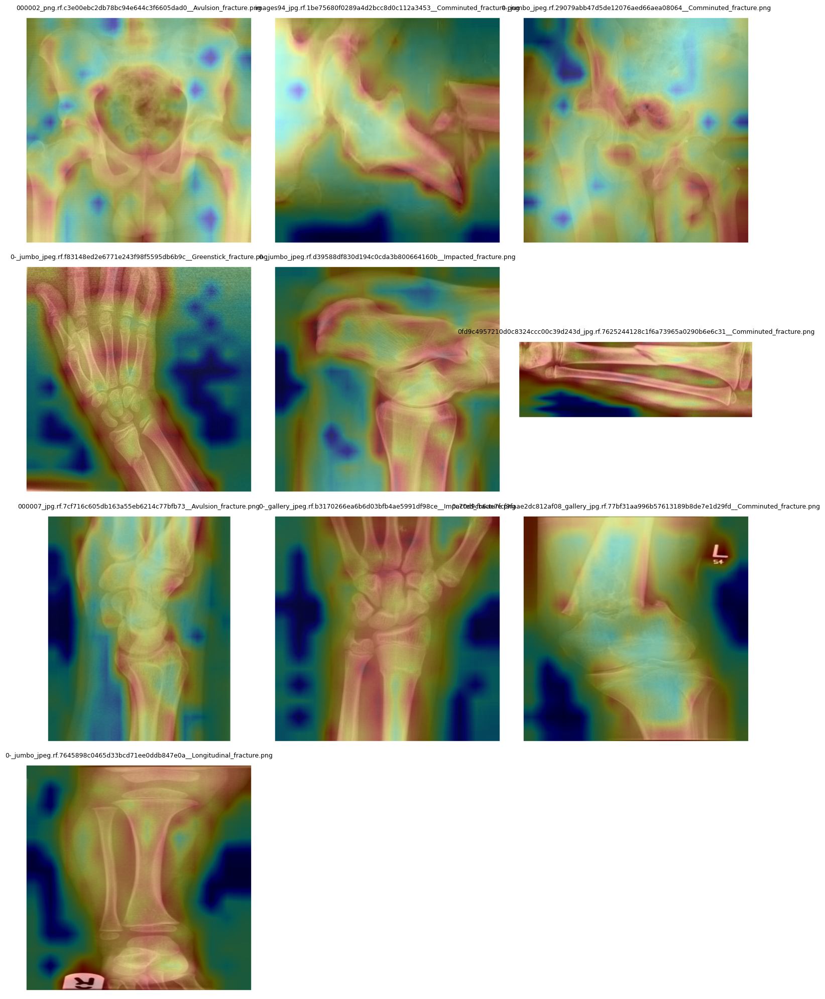

In [19]:
# === Finetune ViT with A/B/C + (1)(2)(3), then show LeGrad on the first Test image per class ===
# !pip install -q transformers timm pillow torchvision

import os, math, random
from pathlib import Path
from typing import List, Tuple, Dict

import torch
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms as T
from transformers import AutoImageProcessor, AutoModelForImageClassification, get_cosine_schedule_with_warmup

# ----------------------------
# Config
# ----------------------------
device = "cuda" if torch.cuda.is_available() else "cpu"
ROOT = Path("/content/data/bone-break/Bone Break Classification/Bone Break Classification")
OUT_DIR = Path("/content/legrad_vit_first_per_class_finetuned")
OUT_DIR.mkdir(parents=True, exist_ok=True)

MODEL_ID = "google/vit-base-patch16-224"
EPOCHS = 10
BATCH_SIZE = 16
# (1) Higher LR for head; lower LR for backbone (set below in param groups)
LR_HEAD = 2e-3
LR_BACKBONE = 1e-5
WEIGHT_DECAY = 0.05
LABEL_SMOOTH = 0.1
IMAGE_SIZE = 448
ALPHA = 0.35
SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)

IMG_EXTS = {".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".gif"}
use_amp = (device == "cuda")

# ----------------------------
# Discover classes and split folders
# ----------------------------
def list_class_dirs(root: Path) -> List[Path]:
    return sorted([d for d in root.iterdir() if d.is_dir()], key=lambda p: p.name.lower())

def first_existing(*paths: Path) -> Path | None:
    for p in paths:
        if p is not None and p.exists():
            return p
    return None

class_dirs = list_class_dirs(ROOT)
classes = [d.name for d in class_dirs]
num_labels = len(classes)
label2id = {c:i for i,c in enumerate(classes)}
id2label = {i:c for c,i in label2id.items()}
print(f"Detected {num_labels} classes:", classes)

# ----------------------------
# Build Train/Test file lists from each class directory
# ----------------------------
def iter_images(d: Path) -> List[Path]:
    return [p for p in d.rglob("*") if p.is_file() and p.suffix.lower() in IMG_EXTS]

train_files, test_files = [], []
for cdir in class_dirs:
    train_dir = first_existing(cdir / "Train", cdir / "train")
    test_dir  = first_existing(cdir / "Test",  cdir / "test", cdir)  # fallback: top-level if no Test/

    if train_dir:
        train_files += [(p, label2id[cdir.name]) for p in iter_images(train_dir)]
    if test_dir:
        test_files  += [(p,  label2id[cdir.name]) for p in iter_images(test_dir)]

print(f"Train images: {len(train_files)} | Test images: {len(test_files)}")
if len(train_files) == 0:
    raise RuntimeError("No training images found under any */Train or */train subfolder.")

# ----------------------------
# A) Stratified Train/Val split (e.g., 90/10)
# ----------------------------
from collections import defaultdict
by_cls = defaultdict(list)
for p, y in train_files:
    by_cls[y].append((p, y))

train_split, val_split = [], []
for y, items in by_cls.items():
    items = sorted(items, key=lambda z: z[0].as_posix().lower())
    k = max(1, int(0.1 * len(items)))  # 10% to val
    val_split.extend(items[:k])
    train_split.extend(items[k:])

print(f"Split -> train: {len(train_split)}, val: {len(val_split)}, test: {len(test_files)}")

# (3) Class weights (inverse frequency)
import numpy as np
# After you build train_split
import numpy as np
train_labels = [y for _, y in train_split]
counts = np.bincount(train_labels, minlength=num_labels)
class_weights = (counts.max() / np.maximum(counts, 1)).astype(np.float32)
class_weights_t = torch.tensor(class_weights, device=device)

# Focal loss (multiclass) with class weights
def focal_loss(logits, targets, gamma=1.5, alpha=None, label_smoothing=0.0):
    # logits: [B,C], targets: [B]
    ce = F.cross_entropy(logits, targets, weight=alpha, reduction="none",
                         label_smoothing=label_smoothing)
    # p_t = softmax prob at true class
    with torch.no_grad():
        pt = torch.softmax(logits, dim=-1).gather(1, targets.unsqueeze(1)).squeeze(1).clamp_(1e-6, 1.0)
    loss = ((1 - pt) ** gamma) * ce
    return loss.mean()

# ----------------------------
# Processor + B) Augmentations
# ----------------------------
processor = AutoImageProcessor.from_pretrained(MODEL_ID, use_fast=True)
mean = getattr(processor, "image_mean", [0.5, 0.5, 0.5])
std  = getattr(processor, "image_std",  [0.5, 0.5, 0.5])

TRAIN_SIZE = 224  # <— bump training/eval size; ViT pos-embed will interpolate
from torchvision import transforms as T

train_tfms = T.Compose([
    T.Resize(int(TRAIN_SIZE * 1.10)),
    T.RandomResizedCrop(TRAIN_SIZE, scale=(0.75, 1.0), ratio=(0.98, 1.02)),  # gentle geometry
    # T.RandomHorizontalFlip(p=0.3),  # enable only if laterality is not informative
    T.RandomRotation(degrees=5),
    # MEDICAL-FRIENDLY INTENSITY AUGS:
    T.RandomAutocontrast(p=0.3),
    T.RandomAdjustSharpness(sharpness_factor=1.5, p=0.3),
    T.RandomEqualize(p=0.2),
    T.ToTensor(),
    T.Normalize(mean=mean, std=std),
])

val_tfms = T.Compose([
    T.Resize(int(TRAIN_SIZE * 1.10)),
    T.CenterCrop(TRAIN_SIZE),
    T.ToTensor(),
    T.Normalize(mean=mean, std=std),
])


class ImgDataset(Dataset):
    def __init__(self, pairs: List[Tuple[Path,int]], transform):
        self.pairs, self.transform = pairs, transform
    def __len__(self): return len(self.pairs)
    def __getitem__(self, i):
        path, y = self.pairs[i]
        img = Image.open(path).convert("RGB")
        x = self.transform(img)
        return x, y, str(path)

def collate(batch):
    xs, ys, paths = zip(*batch)
    xs = torch.stack(xs, dim=0)
    ys = torch.tensor(ys, dtype=torch.long)
    return xs, ys, paths

train_loader = DataLoader(
    ImgDataset(train_split, train_tfms),
    batch_size=BATCH_SIZE,
    shuffle=True,               # or sampler=sampler (and shuffle=False)
    num_workers=2,
    pin_memory=use_amp,
    collate_fn=collate
)
val_loader   = DataLoader(ImgDataset(val_split,   val_tfms),   batch_size=BATCH_SIZE*2, shuffle=False,
                          num_workers=2, pin_memory=use_amp, collate_fn=collate)
test_loader  = DataLoader(ImgDataset(test_files,  val_tfms),   batch_size=BATCH_SIZE*2, shuffle=False,
                          num_workers=2, pin_memory=use_amp, collate_fn=collate)

# ----------------------------
# Model
# ----------------------------
from transformers import get_cosine_schedule_with_warmup

model = AutoModelForImageClassification.from_pretrained(
    MODEL_ID,
    num_labels=num_labels, id2label=id2label, label2id=label2id,
    output_attentions=True, ignore_mismatched_sizes=True,
).to(device)

# Build layer-wise parameter groups (last layers get higher LR)
def build_param_groups_llrd(model,
                            base_lr_backbone=1e-4,
                            lr_head=2e-3,
                            weight_decay=0.05,
                            layer_decay=0.75):
    """
    Build disjoint param groups:
      - classifier head (lr_head)
      - vit.encoder.layer.0..11 with layer-wise lr decay
      - vit.embeddings + global vit.layernorm (smallest lr)
      - (optional) leftovers group if anything remains
    """
    groups = []
    used = set()

    def add_group(named_params, lr):
        # ensure uniqueness
        params = []
        for n, p in named_params:
            if p.requires_grad and id(p) not in used:
                params.append(p)
                used.add(id(p))
        if params:
            groups.append({"params": params, "lr": lr, "weight_decay": weight_decay})

    # 1) Head
    head_named = [(n, p) for n, p in model.named_parameters() if n.startswith("classifier")]
    add_group(head_named, lr_head)

    # 2) Encoder blocks (0..11), smaller lr for early layers, larger for later
    for i in range(12):
        prefix = f"vit.encoder.layer.{i}"
        layer_named = [(n, p) for n, p in model.named_parameters() if n.startswith(prefix)]
        lr_i = base_lr_backbone * (layer_decay ** (11 - i))
        add_group(layer_named, lr_i)

    # 3) Embeddings + global layernorm
    embed_named = [(n, p) for n, p in model.named_parameters()
                   if n.startswith("vit.embeddings") or n.startswith("vit.layernorm")]
    add_group(embed_named, base_lr_backbone * (layer_decay ** 12))

    # 4) (Optional) any leftovers, just in case (very conservative lr)
    leftovers = [(n, p) for n, p in model.named_parameters() if p.requires_grad and id(p) not in used]
    if leftovers:
        # You can print to see what's left: print([n for n,_ in leftovers])
        add_group(leftovers, base_lr_backbone * (layer_decay ** 12))

    # Sanity: no dupes
    assert len(used) == len({id(p) for _, p in model.named_parameters() if p.requires_grad}), \
        "Some trainable params were not grouped or duplicates slipped in."
    return groups

optimizer = torch.optim.AdamW(
    build_param_groups_llrd(
        model,
        base_lr_backbone=1e-4,
        lr_head=2e-3,
        weight_decay=WEIGHT_DECAY,
        layer_decay=0.75,
    )
)

num_train_steps = EPOCHS * len(train_loader)
sched = get_cosine_schedule_with_warmup(
    optimizer,
    num_warmup_steps=max(10, int(0.02 * max(1, num_train_steps))),  # very short warmup on small data
    num_training_steps=max(1, num_train_steps),
)
scaler = torch.amp.GradScaler(enabled=use_amp)

# (2) Gradual unfreeze: at epoch 2, unfreeze last 4 blocks + layer norms with small LR
def unfreeze_last_blocks():
    to_unfreeze = []
    last_blocks = [f"vit.encoder.layer.{i}" for i in [8, 9, 10, 11]]
    for n, p in model.named_parameters():
        if any(n.startswith(b) for b in last_blocks) or n.startswith("vit.layernorm"):
            if not p.requires_grad:
                p.requires_grad = True
                to_unfreeze.append(p)
    if to_unfreeze:
        optimizer.add_param_group({"params": to_unfreeze, "lr": LR_BACKBONE, "weight_decay": WEIGHT_DECAY})
        print(f"Unfroze {len(to_unfreeze)} backbone params with lr={LR_BACKBONE:g}")

def run_epoch(loader, train: bool):
    model.train(mode=train)
    total=correct=0; loss_sum=0.0
    for x,y,_ in loader:
        x,y = x.to(device, non_blocking=use_amp), y.to(device, non_blocking=use_amp)
        if train: optimizer.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type="cuda", dtype=torch.float16, enabled=use_amp):
            out = model(pixel_values=x, labels=None, output_attentions=False)
            logits = out.logits
            loss = focal_loss(logits, y, gamma=1.5, alpha=class_weights_t, label_smoothing=0.05)
        if train:
            scaler.scale(loss).backward()
            scaler.step(optimizer); scaler.update(); sched.step()
        pred = logits.argmax(-1)
        correct += (pred == y).sum().item()
        total += y.numel()
        loss_sum += float(loss) * y.numel()
    return loss_sum / max(total,1), correct / max(total,1)

best_val = -1.0; best_state = None
for epoch in range(1, EPOCHS+1):
    tr_loss, tr_acc = run_epoch(train_loader, train=True)
    vl_loss, vl_acc = run_epoch(val_loader,   train=False)
    print(f"Epoch {epoch:02d} | train_loss={tr_loss:.4f} acc={tr_acc:.3f} | val_loss={vl_loss:.4f} acc={vl_acc:.3f}")
    if vl_acc > best_val:
        best_val = vl_acc
        best_state = {k: v.detach().cpu() for k,v in model.state_dict().items()}

if best_state: model.load_state_dict(best_state, strict=False)
te_loss, te_acc = run_epoch(test_loader, train=False)
print(f"[Final] test_loss={te_loss:.4f} acc={te_acc:.3f}")

# ===== LeGrad (unchanged) =====
model.eval()
ID2LABEL = model.config.id2label

def first_image_in_dir(d: Path) -> Path | None:
    imgs = sorted([p for p in d.rglob("*") if p.is_file() and p.suffix.lower() in IMG_EXTS],
                  key=lambda p: p.as_posix().lower())
    return imgs[0] if imgs else None

def list_first_images_per_class(root: Path) -> Dict[str, Path]:
    out = {}
    for cdir in class_dirs:
        tdir = first_existing(cdir / "Test", cdir / "test", cdir)
        img = first_image_in_dir(tdir) if tdir else None
        if img is not None:
            out[cdir.name] = img
    return out

per_class = list_first_images_per_class(ROOT)
print(f"Classes with a first test image: {len(per_class)}")

def compute_legrad_vit(image_pil: Image.Image, target_index: int | None = None, image_size: int = IMAGE_SIZE):
    img_resized = image_pil.resize((image_size, image_size), Image.BILINEAR)
    vis_inputs = processor(images=img_resized, return_tensors="pt")
    pixel_values = vis_inputs["pixel_values"].to(device)
    pixel_values.requires_grad_(True)

    out = model(pixel_values=pixel_values, output_attentions=True)
    logits = out.logits
    if target_index is None:
        target_index = int(logits.argmax(dim=-1).item())

    for a in out.attentions: a.retain_grad()
    loss = logits[0, target_index]
    model.zero_grad(set_to_none=True); loss.backward(retain_graph=False)

    grads_per_layer = []
    for a in out.attentions:
        g = a.grad
        if g is None: continue
        g = F.relu(g).mean(dim=1)    # [1, T, T]
        grads_per_layer.append(g[0]) # [T, T]
    if not grads_per_layer:
        raise RuntimeError("No attention gradients captured.")
    G = torch.stack(grads_per_layer, dim=0).sum(dim=0)  # [T,T]
    G = G[1:, 1:]                                       # drop [CLS]
    patch_scores = F.relu(G.sum(dim=0))
    patch_scores = patch_scores / (patch_scores.max() + 1e-8)

    side = int(np.sqrt(patch_scores.numel()))
    heat = patch_scores.reshape(side, side).detach().cpu().numpy().astype(np.float32)

    heat_img = Image.fromarray((heat * 255).astype(np.uint8)).resize((image_size, image_size), Image.BILINEAR)
    heat = np.array(heat_img, dtype=np.float32) / 255.0
    return heat, target_index

def save_overlay(pil_img: Image.Image, heat: np.ndarray, out_path: Path, alpha: float = ALPHA):
    W, H = pil_img.size
    hm = Image.fromarray((heat * 255).astype(np.uint8)).resize((W, H), Image.BILINEAR)
    plt.figure(figsize=(6, 6))
    plt.imshow(pil_img)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off"); plt.tight_layout()
    out_path.parent.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=150, bbox_inches="tight"); plt.close()

# Run LeGrad on first test image per class
outputs: List[Tuple[Path, str]] = []
for cls_name, img_path in per_class.items():
    raw = Image.open(img_path).convert("RGB")
    heat, cls_idx = compute_legrad_vit(raw)
    pred_label = ID2LABEL.get(cls_idx, f"class_{cls_idx}")
    out_png = OUT_DIR / f"{Path(img_path).stem}__{pred_label.replace(' ', '_')}.png"
    save_overlay(raw, heat, out_png)
    outputs.append((out_png, f"{cls_name} → {pred_label}"))

print(f"Saved {len(outputs)} overlays to: {OUT_DIR}")

# Display grid
cols = 3
rows = math.ceil(len(outputs) / cols) if outputs else 1
plt.figure(figsize=(5*cols, 5*rows))
for i, (op, lbl) in enumerate(outputs, start=1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(Path(op).name, fontsize=9)
    ax.set_xlabel(lbl, fontsize=8)
    ax.axis("off")
plt.tight_layout(); plt.show()

In [20]:
# ----------------------------
# Evaluation utilities for fine-tuned ViT
# ----------------------------
from collections import defaultdict

@torch.no_grad()
def eval_model(loader, split_name="val", topk=(1,3)):
    model.eval()
    total = 0
    loss_sum = 0.0
    topk_correct = {k: 0 for k in topk}
    per_cls_correct = defaultdict(int)
    per_cls_total = defaultdict(int)
    y_true = []
    y_pred = []

    for xb, yb, _paths in loader:
        xb = xb.to(device)
        yb = yb.to(device)
        out = model(pixel_values=xb, labels=yb, output_attentions=False)
        logits = out.logits
        loss = out.loss

        # overall stats
        B = yb.size(0)
        total += B
        loss_sum += float(loss) * B

        # top-k
        max_k = max(topk)
        _, pred_topk = logits.topk(max_k, dim=1)  # [B, max_k]
        for k in topk:
            topk_correct[k] += (pred_topk[:, :k].eq(yb.unsqueeze(1))).any(dim=1).sum().item()

        # per-class
        pred1 = pred_topk[:, 0]
        for t, p in zip(yb.tolist(), pred1.tolist()):
            per_cls_total[t] += 1
            per_cls_correct[t] += int(t == p)
            y_true.append(t)
            y_pred.append(p)

    avg_loss = loss_sum / max(total, 1)
    topk_acc = {f"top{k}_acc": topk_correct[k] / max(total, 1) for k in topk}

    # per-class table
    per_class = []
    for cid in range(num_labels):
        cls_name = id2label[cid]
        tot = per_cls_total[cid]
        cor = per_cls_correct[cid]
        acc = (cor / tot) if tot > 0 else float("nan")
        per_class.append({"class_id": cid, "class": cls_name, "support": tot, "acc": acc})

    # Pretty print
    print(f"[{split_name}] loss={avg_loss:.4f} " + " ".join([f"{k}={v:.3f}" for k,v in topk_acc.items()]))
    print("Per-class accuracy:")
    for row in sorted(per_class, key=lambda r: (-r["support"], r["class"])):
        sup = row["support"]
        acc = row["acc"]
        print(f"  - {row['class']:<24} acc={acc:.3f} (n={sup})")

    return {
        "split": split_name,
        "loss": avg_loss,
        **topk_acc,
        "per_class": per_class,
        "y_true": y_true,
        "y_pred": y_pred,
    }

# ---- Run evaluations (after training / best_state load) ----
metrics_val  = eval_model(val_loader,  split_name="val",  topk=(1,3))
metrics_test = eval_model(test_loader, split_name="test", topk=(1,3))

# (Optional) confusion matrix without extra deps
def confusion_matrix_from_preds(y_true, y_pred, num_classes):
    cm = torch.zeros((num_classes, num_classes), dtype=torch.int64)
    for t, p in zip(y_true, y_pred):
        cm[t, p] += 1
    return cm

cm_test = confusion_matrix_from_preds(metrics_test["y_true"], metrics_test["y_pred"], num_labels)
print("\n[Test] Confusion matrix (rows=true, cols=pred):")
print(cm_test.numpy())

# (Optional) save metrics
# import json, pathlib
# with open(OUT_DIR / "metrics_finetuned.json", "w") as f:
#     json.dump({"val": metrics_val, "test": metrics_test}, f, indent=2)

[val] loss=1.9728 top1_acc=0.387 top3_acc=0.667
Per-class accuracy:
  - Comminuted fracture      acc=0.615 (n=13)
  - Fracture Dislocation     acc=0.231 (n=13)
  - Pathological fracture    acc=0.545 (n=11)
  - Avulsion fracture        acc=0.500 (n=10)
  - Greenstick fracture      acc=0.500 (n=10)
  - Hairline Fracture        acc=0.300 (n=10)
  - Impacted fracture        acc=0.143 (n=7)
  - Spiral Fracture          acc=0.286 (n=7)
  - Longitudinal fracture    acc=0.333 (n=6)
  - Oblique fracture         acc=0.167 (n=6)
[test] loss=1.7514 top1_acc=0.457 top3_acc=0.679
Per-class accuracy:
  - Fracture Dislocation     acc=0.526 (n=19)
  - Pathological fracture    acc=0.167 (n=18)
  - Greenstick fracture      acc=0.875 (n=16)
  - Oblique fracture         acc=0.062 (n=16)
  - Avulsion fracture        acc=0.786 (n=14)
  - Comminuted fracture      acc=0.643 (n=14)
  - Longitudinal fracture    acc=0.333 (n=12)
  - Spiral Fracture          acc=0.500 (n=12)
  - Hairline Fracture        acc=0.300 

## OpenCLIP ViT (Text Prompt on Zero-shot Classification) with LeGrad

In [29]:
# --- Setup & imports ---
import os, random, json
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn.functional as F
import open_clip

from legrad import LeWrapper, LePreprocess
from legrad.utils import visualize

import numpy as np

# --- Device ---
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device:", device)

# --- Dataset roots (adjust if needed) ---
ROOT = Path("/content/data/bone-break/Bone Break Classification/Bone Break Classification")

IMG_EXTS = {".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".gif"}

def has_any_images(dirpath: Path) -> bool:
    if not dirpath.exists() or not dirpath.is_dir():
        return False
    for p in dirpath.rglob("*"):
        if p.is_file() and p.suffix.lower() in IMG_EXTS:
            return True
    return False

def image_iter(dirpath: Path):
    for p in dirpath.rglob("*"):
        if p.is_file() and p.suffix.lower() in IMG_EXTS:
            yield p

def resolve_search_dir(class_dir: Path) -> Path | None:
    # Prefer Train/train subfolder if present and non-empty
    for name in ("Train", "train"):
        cand = class_dir / name
        if cand.is_dir() and has_any_images(cand):
            return cand
    # Else fall back to images directly under class_dir
    if has_any_images(class_dir):
        return class_dir
    return None

# Discover classes & build image list
class_dirs = []
for child in sorted([d for d in ROOT.iterdir() if d.is_dir()], key=lambda x: x.name.lower()):
    sdir = resolve_search_dir(child)
    if sdir is not None:
        class_dirs.append((child.name, sdir))

if not class_dirs:
    raise RuntimeError(f"No classes with images found under {ROOT}")

classes = [name for name, _ in class_dirs]
print("Classes:", classes)

all_imgs = []
for name, sdir in class_dirs:
    all_imgs.extend(list(image_iter(sdir)))

print(f"Total images found: {len(all_imgs)}")

# --- OpenCLIP model ---
MODEL_NAME = "ViT-B-16"
PRETRAINED = "laion2b_s34b_b88k"

model, _, preprocess = open_clip.create_model_and_transforms(
    model_name=MODEL_NAME, pretrained=PRETRAINED, device=device
)
tokenizer = open_clip.get_tokenizer(model_name=MODEL_NAME)
model.eval()

# Equip with LeGrad (adds .compute_legrad_clip)
model = LeWrapper(model)
# Optional: higher-res preprocessing for sharper attribution maps
preprocess = LePreprocess(preprocess=preprocess, image_size=448)

print("Ready:", MODEL_NAME, PRETRAINED, "on", device)

# --- Build zero-shot prompts from class names ---
def build_prompts(cls_names):
    base = "an X-ray of {label}"
    return [base.format(label=c.replace("_", " ")) for c in cls_names]

prompts = build_prompts(classes)
print("Example prompts:", prompts[:4])

# --- Tokenize & encode all class prompts ONCE (and normalize) ---
with torch.no_grad():
    text_tok = tokenizer(prompts).to(device)               # [num_classes, ctx_len]
    text_feat = model.encode_text(text_tok)                # [num_classes, d]
    text_emb = F.normalize(text_feat, dim=-1)              # normalized for cosine sims

print("text_emb:", tuple(text_emb.shape))

# --- LeGrad helper ---
def save_legrad_overlay(raw_pil: Image.Image, heat, out_path: str, alpha: float = 0.35):
    """
    Draw a heatmap overlay on top of the raw PIL image and save to out_path.
    Accepts heat as torch.Tensor or numpy array in shapes:
      [1, H, W], [H, W], [1, 1, H, W], or similar.
    """
    # --- normalize heat to [0,1] and upsample to image size ---
    if hasattr(heat, "detach"):  # torch.Tensor
        h = heat.detach().cpu().float()
        # squeeze to [H,W]
        while h.dim() > 2:
            h = h[0]
        h = h.numpy()
    else:
        h = np.array(heat)

    h = h.astype(np.float32)
    h -= h.min()
    h /= (h.max() + 1e-8)

    # match sizes
    W, H = raw_pil.size
    hm = Image.fromarray((h * 255).astype(np.uint8)).resize((W, H), Image.BILINEAR)

    # --- plot overlay ---
    plt.figure(figsize=(6, 6))
    plt.imshow(raw_pil)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off")
    plt.tight_layout()
    plt.savefig(out_path, dpi=150, bbox_inches="tight")
    plt.close()

def legrad_for_image(img_path, save_dir="/content/legrad_outputs"):
    os.makedirs(save_dir, exist_ok=True)

    # Load once as PIL for overlay; also build the tensor that REQUIRES grad for LeGrad
    raw = Image.open(img_path).convert("RGB")
    image_ = preprocess(raw).unsqueeze(0).to(device)
    image_.requires_grad_(True)

    # Classify under no_grad (ok)
    with torch.no_grad():
        img_feat = model.encode_image(image_)            # [1, d]
        img_emb  = F.normalize(img_feat, dim=-1)
        logits   = img_emb @ text_emb.T                  # [1, C]
        top_idx  = torch.argmax(logits, dim=-1).item()

    pred_label  = classes[top_idx]
    pred_prompt = prompts[top_idx]
    print(f"Pred: {pred_label} | prompt: {pred_prompt}")

    # Compute LeGrad (NO torch.no_grad here)
    heat = model.compute_legrad_clip(
        image=image_,
        text_embedding=text_emb[top_idx:top_idx+1]       # or: text=text_tok[top_idx:top_idx+1]
    )

    # Save overlay
    out_png = os.path.join(save_dir, f"{Path(img_path).stem}__{pred_label}.png")
    save_legrad_overlay(raw_pil=raw, heat=heat, out_path=out_png, alpha=0.35)
    return out_png, pred_label


# --- Try it on a few images ---
sample_k = min(4, len(all_imgs))
for p in random.sample(all_imgs, k=sample_k):
    out, lbl = legrad_for_image(str(p))
    print("Saved:", out)


/usr/local/lib/python3.12/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


Device: cuda
Classes: ['Avulsion fracture', 'Comminuted fracture', 'Fracture Dislocation', 'Greenstick fracture', 'Hairline Fracture', 'Impacted fracture', 'Longitudinal fracture', 'Oblique fracture', 'Pathological fracture', 'Spiral Fracture']
Total images found: 989


open_clip_pytorch_model.bin:   0%|          | 0.00/599M [00:00<?, ?B/s]

Activating necessary hooks and gradients ....
Hooks and gradients activated!
Ready: ViT-B-16 laion2b_s34b_b88k on cuda
Example prompts: ['an X-ray of Avulsion fracture', 'an X-ray of Comminuted fracture', 'an X-ray of Fracture Dislocation', 'an X-ray of Greenstick fracture']
text_emb: (10, 512)
Pred: Fracture Dislocation | prompt: an X-ray of Fracture Dislocation
Saved: /content/legrad_outputs/41598_2020_64479_Fig2_HTML_png.rf.6d72e2fe8092ce099dd60b6e8056b525__Fracture Dislocation.png
Pred: Oblique fracture | prompt: an X-ray of Oblique fracture
Saved: /content/legrad_outputs/image14_jpeg.rf.25e75522b4a8c5d99690d62402ef16f9__Oblique fracture.png
Pred: Impacted fracture | prompt: an X-ray of Impacted fracture
Saved: /content/legrad_outputs/Segond-Fx-label-2_png.rf.ebecbcb0ff8e7e06cb974569469__Impacted fracture.png
Pred: Pathological fracture | prompt: an X-ray of Pathological fracture
Saved: /content/legrad_outputs/xray-image-foot-ap-oblique-600w-267976154_jpg.rf.54b9ad550bab02b311438c8

[Eval setup] images=140 | classes=10
[Zero-shot OpenCLIP] top1=0.150 | top3=0.386
Per-class accuracy:
  - Avulsion fracture        acc=0.071 (n=14)
  - Comminuted fracture      acc=0.000 (n=14)
  - Fracture Dislocation     acc=0.421 (n=19)
  - Greenstick fracture      acc=0.000 (n=16)
  - Hairline Fracture        acc=0.000 (n=10)
  - Impacted fracture        acc=0.111 (n=9)
  - Longitudinal fracture    acc=0.167 (n=12)
  - Oblique fracture         acc=0.500 (n=16)
  - Pathological fracture    acc=0.056 (n=18)
  - Spiral Fracture          acc=0.000 (n=12)

[Test] Confusion matrix (rows=true, cols=pred):
[[1 0 5 0 0 1 2 1 4 0]
 [0 0 4 0 0 0 1 9 0 0]
 [3 0 8 0 0 0 1 4 3 0]
 [0 0 3 0 0 0 5 7 1 0]
 [1 0 1 0 0 1 0 6 0 1]
 [1 0 2 1 0 1 1 2 1 0]
 [3 0 2 0 0 1 2 4 0 0]
 [2 1 4 0 0 0 1 8 0 0]
 [1 1 3 0 0 1 0 8 1 3]
 [0 0 4 0 0 0 1 7 0 0]]
Classes with a first eval image: 10 / 10
Pred: Impacted fracture | prompt: an X-ray of Impacted fracture
Pred: Oblique fracture | prompt: an X-ray of Oblique f

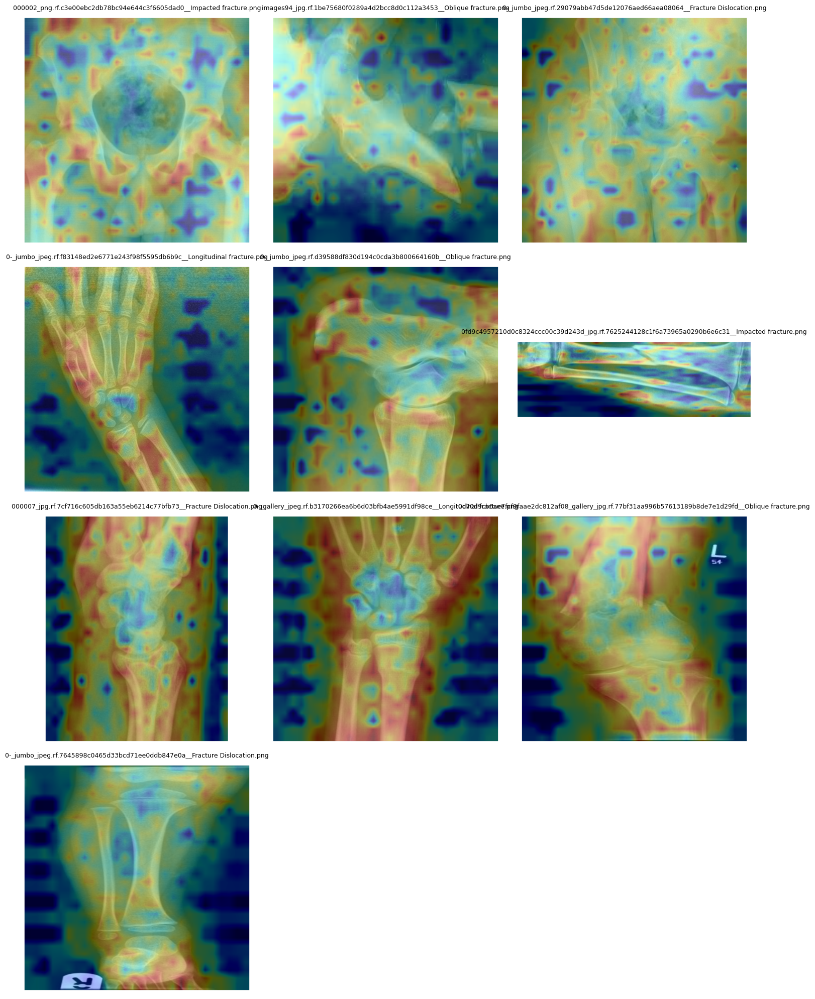

In [30]:
# =========================
# Zero-shot EVAL + LeGrad overlays (OpenCLIP)
# =========================
import torch
import numpy as np
from collections import defaultdict
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt

# --- Prefer Test/ for eval; fallback to class root if Test/ is missing ---
def resolve_eval_dir(class_dir: Path) -> Path | None:
    for name in ("Test", "test"):
        cand = class_dir / name
        if cand.is_dir() and has_any_images(cand):
            return cand
    if has_any_images(class_dir):
        return class_dir
    return None

# Build eval pairs [(path, y)]
eval_pairs = []
name2id = {c:i for i, c in enumerate(classes)}
id2label = {i:c for c, i in name2id.items()}

for cls_name, class_root in [(n, ROOT / n) for n in classes]:
    edir = resolve_eval_dir(class_root)
    if edir is None:
        continue
    for p in image_iter(edir):
        eval_pairs.append((p, name2id[cls_name]))

print(f"[Eval setup] images={len(eval_pairs)} | classes={len(classes)}")

# --- Zero-shot evaluation (batched) ---
@torch.no_grad()
def zeroshot_eval_openclip(pairs, batch_size=32):
    model.eval()
    C = len(classes)
    cm = torch.zeros(C, C, dtype=torch.long)
    per_cls_hits = defaultdict(int); per_cls_cnt = defaultdict(int)
    total = correct = top3 = 0

    # simple batching
    for i in range(0, len(pairs), batch_size):
        chunk = pairs[i:i+batch_size]
        imgs = [Image.open(p).convert("RGB") for p, _ in chunk]
        ys   = torch.tensor([y for _, y in chunk], dtype=torch.long)

        # preprocess (OpenCLIP transform)
        xb = torch.stack([preprocess(im) for im in imgs], dim=0).to(device)

        # image embeds
        img_feat = model.encode_image(xb)              # [B, d]
        img_emb  = F.normalize(img_feat, dim=-1)       # [B, d]
        logits   = img_emb @ text_emb.T                # [B, C]

        probs = logits.softmax(-1)
        pred  = probs.argmax(-1).cpu()
        ys    = ys.cpu()

        total   += ys.numel()
        correct += (pred == ys).sum().item()

        topk = probs.topk(k=min(3, C), dim=-1).indices.cpu()
        top3 += (topk == ys.unsqueeze(1)).any(dim=1).sum().item()

        for t, p in zip(ys.view(-1), pred.view(-1)):
            cm[t, p] += 1
            per_cls_cnt[int(t)] += 1
            if t == p:
                per_cls_hits[int(t)] += 1

    top1 = correct / max(total, 1)
    top3_acc = top3 / max(total, 1)
    per_class = [
        (id2label[i], f"{(per_cls_hits[i]/max(per_cls_cnt[i],1)):.3f}", per_cls_cnt[i])
        for i in range(C)
    ]
    return top1, top3_acc, cm, per_class

# ---- Run eval ----
top1, top3, cm, per_class = zeroshot_eval_openclip(eval_pairs, batch_size=32)
print(f"[Zero-shot OpenCLIP] top1={top1:.3f} | top3={top3:.3f}")
print("Per-class accuracy:")
for name, acc, n in per_class:
    print(f"  - {name:<24} acc={acc} (n={n})")

print("\n[Test] Confusion matrix (rows=true, cols=pred):")
print(cm.numpy())

# =========================
# LeGrad overlays (one per class)
# =========================
# Pick first image per class, from the *eval* set we just built
per_class_first = {}
for p, y in sorted(eval_pairs, key=lambda t: t[0].as_posix().lower()):
    cname = id2label[y]
    if cname not in per_class_first:
        per_class_first[cname] = p
print(f"Classes with a first eval image: {len(per_class_first)} / {len(classes)}")

# Directory for overlays
OUT_DIR = Path("/content/legrad_zeroshot_overlays")
OUT_DIR.mkdir(parents=True, exist_ok=True)

# Use your existing CLIP LeGrad helper
#   legrad_for_image(img_path, save_dir=...) -> (out_png, pred_label)

outputs = []
for cls_name, img_path in per_class_first.items():
    out_png, pred_label = legrad_for_image(str(img_path), save_dir=str(OUT_DIR))
    outputs.append((Path(out_png), f"{cls_name} → {pred_label}"))

print(f"Saved {len(outputs)} overlays to: {OUT_DIR}")

# ---- Display grid of overlays ----
cols = 3
rows = int(np.ceil(len(outputs) / cols)) if outputs else 1
plt.figure(figsize=(5*cols, 5*rows))
for i, (op, lbl) in enumerate(outputs, start=1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(op.name, fontsize=9)
    ax.set_xlabel(lbl, fontsize=8)
    ax.axis("off")
plt.tight_layout(); plt.show()

## OpenCLIP ViT + Linear Probe with LeGrad

In [34]:
# ===== Linear Probe on OpenCLIP (frozen image encoder) =====
# pip install open_clip_torch
import torch, torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from pathlib import Path
from typing import List, Tuple
import open_clip

# ---- Config ----
MODEL_NAME = "ViT-B-16"
PRETRAINED  = "laion2b_s34b_b88k"
BATCH = 64
EPOCHS = 10
LR = 1e-3
WD = 0.01
use_amp = (device == "cuda")

num_labels = len(classes)
id2label = {i: c for i, c in enumerate(classes)}

# ---- Load OpenCLIP + preprocess ----
model, _, preprocess = open_clip.create_model_and_transforms(
    model_name=MODEL_NAME, pretrained=PRETRAINED, device=device
)
model.eval()                         # freeze encoder
for p in model.parameters():
    p.requires_grad = False

# Embedding size after encode_image (projected, L2-normalized)
with torch.no_grad():
    dummy = preprocess(Image.new("RGB", (224, 224))).unsqueeze(0).to(device)
    d = model.encode_image(dummy).shape[-1]   # e.g., 512

# ---- Dataset / Dataloaders ----
class ImgDS(Dataset):
    def __init__(self, pairs: List[Tuple[Path,int]]):
        self.pairs = pairs
    def __len__(self): return len(self.pairs)
    def __getitem__(self, i):
        p, y = self.pairs[i]
        img = Image.open(p).convert("RGB")
        x = preprocess(img)
        return x, y

train_ds = ImgDS(train_files)
test_ds  = ImgDS(test_files)

train_loader = DataLoader(train_ds, batch_size=BATCH, shuffle=True,  num_workers=2, pin_memory=use_amp)
test_loader  = DataLoader(test_ds,  batch_size=BATCH, shuffle=False, num_workers=2, pin_memory=use_amp)

# ---- Linear head on frozen embeddings ----
head = nn.Linear(d, num_labels).to(device)
opt = torch.optim.AdamW(head.parameters(), lr=LR, weight_decay=WD)
scaler = torch.amp.GradScaler(enabled=use_amp)

@torch.no_grad()
def extract_embed(xb: torch.Tensor) -> torch.Tensor:
    # OpenCLIP returns L2-normalized features already (good for linear probe)
    return model.encode_image(xb)

def run_epoch(loader, train: bool):
    head.train(train)
    total=correct=0; loss_sum=0.0
    for xb, yb in loader:
        xb, yb = xb.to(device, non_blocking=use_amp), torch.as_tensor(yb, device=device)
        if train: opt.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type="cuda", dtype=torch.float16, enabled=use_amp):
            with torch.no_grad():             # backbone frozen
                feats = extract_embed(xb)      # [B, d]
            logits = head(feats)               # [B, C]
            loss = F.cross_entropy(logits, yb)
        if train:
            scaler.scale(loss).backward()
            scaler.step(opt); scaler.update()
        pred = logits.argmax(-1)
        correct += (pred == yb).sum().item()
        total += yb.numel()
        loss_sum += float(loss) * yb.numel()
    return loss_sum/max(total,1), correct/max(total,1)

@torch.no_grad()
def evaluate(loader):
    head.eval()
    total=correct=0; top3=0
    for xb, yb in loader:
        xb, yb = xb.to(device), torch.as_tensor(yb, device=device)
        feats = extract_embed(xb)
        logits = head(feats)
        probs = logits.softmax(-1)
        pred = probs.argmax(-1)
        total += yb.numel()
        correct += (pred == yb).sum().item()
        top3 += (probs.topk(k=min(3, num_labels), dim=-1).indices == yb.unsqueeze(1)).any(dim=1).sum().item()
    return correct/max(total,1), top3/max(total,1)

# ---- Train linear probe ----
for epoch in range(1, EPOCHS+1):
    tr_loss, tr_acc = run_epoch(train_loader, train=True)
    te_top1, te_top3 = evaluate(test_loader)
    print(f"[OpenCLIP LP] Epoch {epoch:02d} | train_loss={tr_loss:.4f} acc={tr_acc:.3f} | test@1={te_top1:.3f} test@3={te_top3:.3f}")

# ---- Final test ----
top1, top3 = evaluate(test_loader)
print(f"\n[OpenCLIP LP] Final Test: top1={top1:.3f} top3={top3:.3f}")


[OpenCLIP LP] Epoch 01 | train_loss=2.2565 acc=0.160 | test@1=0.207 test@3=0.386
[OpenCLIP LP] Epoch 02 | train_loss=2.1433 acc=0.260 | test@1=0.250 test@3=0.479
[OpenCLIP LP] Epoch 03 | train_loss=2.0541 acc=0.299 | test@1=0.264 test@3=0.514
[OpenCLIP LP] Epoch 04 | train_loss=1.9843 acc=0.332 | test@1=0.264 test@3=0.543
[OpenCLIP LP] Epoch 05 | train_loss=1.9322 acc=0.363 | test@1=0.264 test@3=0.536
[OpenCLIP LP] Epoch 06 | train_loss=1.8830 acc=0.372 | test@1=0.264 test@3=0.529
[OpenCLIP LP] Epoch 07 | train_loss=1.8453 acc=0.389 | test@1=0.286 test@3=0.536
[OpenCLIP LP] Epoch 08 | train_loss=1.8122 acc=0.394 | test@1=0.293 test@3=0.586
[OpenCLIP LP] Epoch 09 | train_loss=1.7763 acc=0.413 | test@1=0.279 test@3=0.579
[OpenCLIP LP] Epoch 10 | train_loss=1.7536 acc=0.427 | test@1=0.293 test@3=0.564

[OpenCLIP LP] Final Test: top1=0.293 top3=0.564


In [35]:
# ==== Add-on: full evaluation (cm + per-class) ====
import numpy as np
import torch
from collections import defaultdict

@torch.no_grad()
def evaluate_full_openclip(loader):
    head.eval()
    total = correct = top3 = 0
    cm = torch.zeros(num_labels, num_labels, dtype=torch.long, device="cpu")
    per_cls_hits = defaultdict(int); per_cls_cnt = defaultdict(int)

    for xb, yb in loader:
        xb = xb.to(device)
        yb = torch.as_tensor(yb, device=device)
        feats = model.encode_image(xb)          # [B, d], L2-normalized
        logits = head(feats)                    # [B, C]
        probs  = logits.softmax(-1)
        pred   = probs.argmax(-1)

        total  += yb.numel()
        correct += (pred == yb).sum().item()

        tk = probs.topk(k=min(3, num_labels), dim=-1).indices
        top3 += (tk == yb.unsqueeze(1)).any(dim=1).sum().item()

        # update cm / per-class (move to cpu for cm)
        for t, p in zip(yb.tolist(), pred.tolist()):
            cm[t, p] += 1
            per_cls_cnt[int(t)] += 1
            if t == p: per_cls_hits[int(t)] += 1

    top1 = correct / max(total, 1)
    top3_acc = top3 / max(total, 1)
    per_class = [(id2label[i],
                  f"{(per_cls_hits[i]/max(per_cls_cnt[i],1)):.3f}",
                  per_cls_cnt[i]) for i in range(num_labels)]
    return top1, top3_acc, cm, per_class

# ---- Final eval printout (same style you used before) ----
top1, top3, cm, per_class = evaluate_full_openclip(test_loader)
print(f"\n[OpenCLIP LP] Final Test top1={top1:.3f} top3={top3:.3f}")
print("Per-class accuracy:")
for name, acc, n in per_class:
    print(f"  - {name:<24} acc={acc} (n={n})")
print("\n[Test] Confusion matrix (rows=true, cols=pred):")
print(cm.numpy())



[OpenCLIP LP] Final Test top1=0.293 top3=0.564
Per-class accuracy:
  - Avulsion fracture        acc=0.500 (n=14)
  - Comminuted fracture      acc=0.500 (n=14)
  - Fracture Dislocation     acc=0.263 (n=19)
  - Greenstick fracture      acc=0.562 (n=16)
  - Hairline Fracture        acc=0.000 (n=10)
  - Impacted fracture        acc=0.111 (n=9)
  - Longitudinal fracture    acc=0.000 (n=12)
  - Oblique fracture         acc=0.062 (n=16)
  - Pathological fracture    acc=0.444 (n=18)
  - Spiral Fracture          acc=0.250 (n=12)

[Test] Confusion matrix (rows=true, cols=pred):
[[7 2 1 0 2 0 0 0 2 0]
 [0 7 1 1 0 0 0 0 5 0]
 [1 0 5 4 3 0 0 1 4 1]
 [1 1 2 9 1 0 0 0 2 0]
 [4 2 1 2 0 0 0 0 1 0]
 [1 0 2 0 1 1 0 0 3 1]
 [5 2 0 1 1 0 0 0 2 1]
 [0 1 2 3 3 0 0 1 5 1]
 [1 0 4 2 0 0 1 0 8 2]
 [1 1 0 3 0 0 1 0 3 3]]


Activating necessary hooks and gradients ....
Hooks and gradients activated!
Classes with a first test image: 10 / 10
Saved 10 overlays to: openclip_lp_legrad_overlays


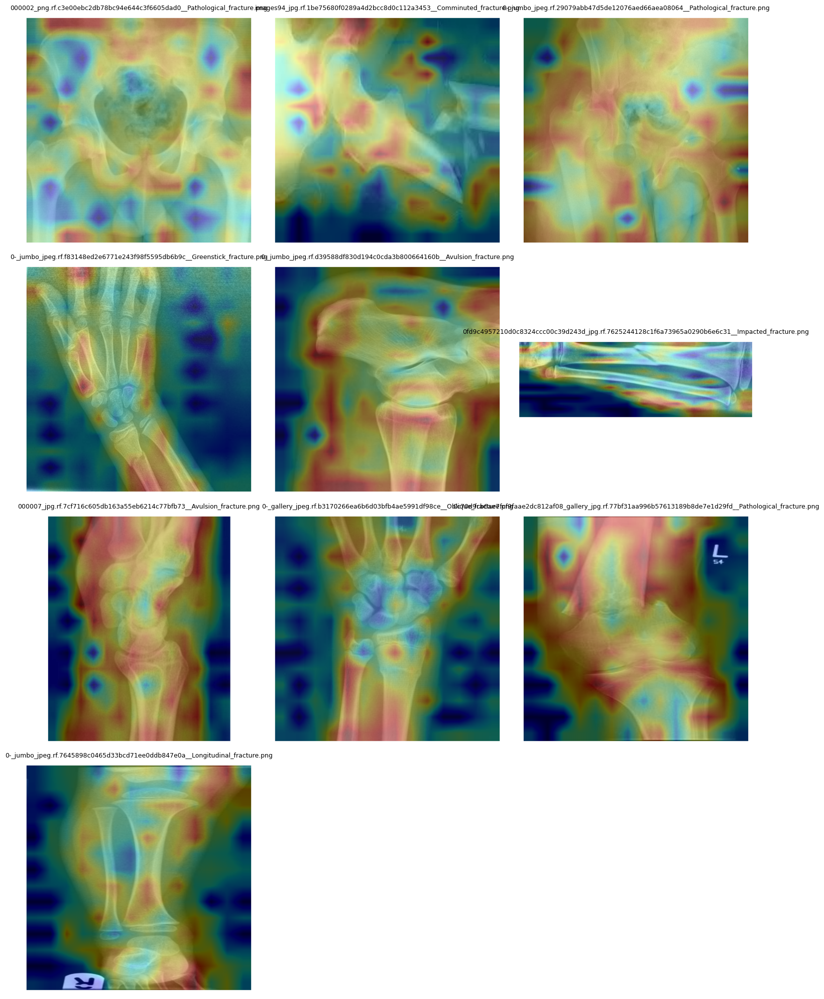

In [37]:
# ==== Add-on: LeGrad overlays using OpenCLIP + LeWrapper (text prompts) ====
# pip install legrad open_clip_torch  (you already have open_clip)
from legrad import LeWrapper, LePreprocess
import torch.nn.functional as F
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path
from typing import Dict, List, Tuple
import math, os

# 1) Wrap OpenCLIP model for LeGrad and bump viz resolution
le_model = LeWrapper(model)                             # adds .compute_legrad_clip
native = getattr(getattr(model, "visual", None), "image_size", 224)
if isinstance(native, (tuple, list)):
    native = native[0]

viz_preprocess = LePreprocess(preprocess, image_size=native)  # typically 224

# 2) Build class prompts (you can tweak the template to your dataset)
def build_prompts(names):
    tmpl = "an X-ray of {label}"
    return [tmpl.format(label=n.replace("_", " ")) for n in names]

prompts = build_prompts(classes)

# 3) Tokenize/encode all prompts once and L2-normalize
tokenizer = open_clip.get_tokenizer(MODEL_NAME)
with torch.no_grad():
    text_tok = tokenizer(prompts).to(device)
    text_feat = le_model.encode_text(text_tok)          # [C, d]
    text_emb  = F.normalize(text_feat, dim=-1)          # [C, d]

# 4) Helper to save overlay
def save_overlay(pil_img: Image.Image, heat, out_path: Path, alpha: float = 0.35):
    import numpy as np
    W, H = pil_img.size
    if hasattr(heat, "detach"):
        h = heat.detach().float().cpu().numpy()
    else:
        h = np.array(heat, dtype=np.float32)
    while h.ndim > 2:  # squeeze to [H, W]
        h = h[0]
    h = h - h.min()
    h = h / (h.max() + 1e-8)
    hm = Image.fromarray((h * 255).astype(np.uint8)).resize((W, H), Image.BILINEAR)

    plt.figure(figsize=(6,6))
    plt.imshow(pil_img)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off"); plt.tight_layout()
    out_path.parent.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=150, bbox_inches="tight"); plt.close()

# 5) Choose first test image per class (deterministic)
per_class_first: Dict[str, Path] = {}
for p, y in sorted(test_files, key=lambda t: t[0].as_posix().lower()):
    cname = id2label[y]
    if cname not in per_class_first:
        per_class_first[cname] = p
print(f"Classes with a first test image: {len(per_class_first)} / {num_labels}")

# 6) Run overlays
OUT_DIR = Path("./openclip_lp_legrad_overlays"); OUT_DIR.mkdir(parents=True, exist_ok=True)

@torch.no_grad()
def predict_with_linear_probe(pil_img: Image.Image) -> int:
    xb = preprocess(pil_img).unsqueeze(0).to(device)
    feats = model.encode_image(xb)         # [1, d], L2-normalized
    logits = head(feats)                   # [1, C]
    return int(logits.argmax(-1).item())

outputs: List[Tuple[Path, str]] = []
for cls_name, img_path in per_class_first.items():
    raw = Image.open(img_path).convert("RGB")

    # (A) get the linear-probe prediction
    pred_idx = predict_with_linear_probe(raw)

    # (B) compute LeGrad using the corresponding text embedding
    img_in = viz_preprocess(raw).unsqueeze(0).to(device)
    img_in.requires_grad_(True)
    heat = le_model.compute_legrad_clip(
        image=img_in,
        text_embedding=text_emb[pred_idx:pred_idx+1]  # 1xD
    )

    # (C) save pretty overlay
    label = id2label.get(pred_idx, f"class_{pred_idx}")
    out_png = OUT_DIR / f"{Path(img_path).stem}__{label.replace(' ', '_')}.png"
    save_overlay(raw, heat, out_png, alpha=0.35)
    outputs.append((out_png, f"{cls_name} → {label}"))

print(f"Saved {len(outputs)} overlays to: {OUT_DIR}")

# 7) Display grid
cols = 3
rows = math.ceil(len(outputs) / cols) if outputs else 1
plt.figure(figsize=(5*cols, 5*rows))
for i, (op, lbl) in enumerate(outputs, start=1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(Path(op).name, fontsize=9)
    ax.set_xlabel(lbl, fontsize=8)
    ax.axis("off")
plt.tight_layout(); plt.show()


## Prompt Ablation OpenCLIP ViT + Linear Probe

Activating necessary hooks and gradients ....
Hooks and gradients activated!
Classes with a first test image: 10 / 10
Saved overlays to: openclip_prompt_ablation_legrad


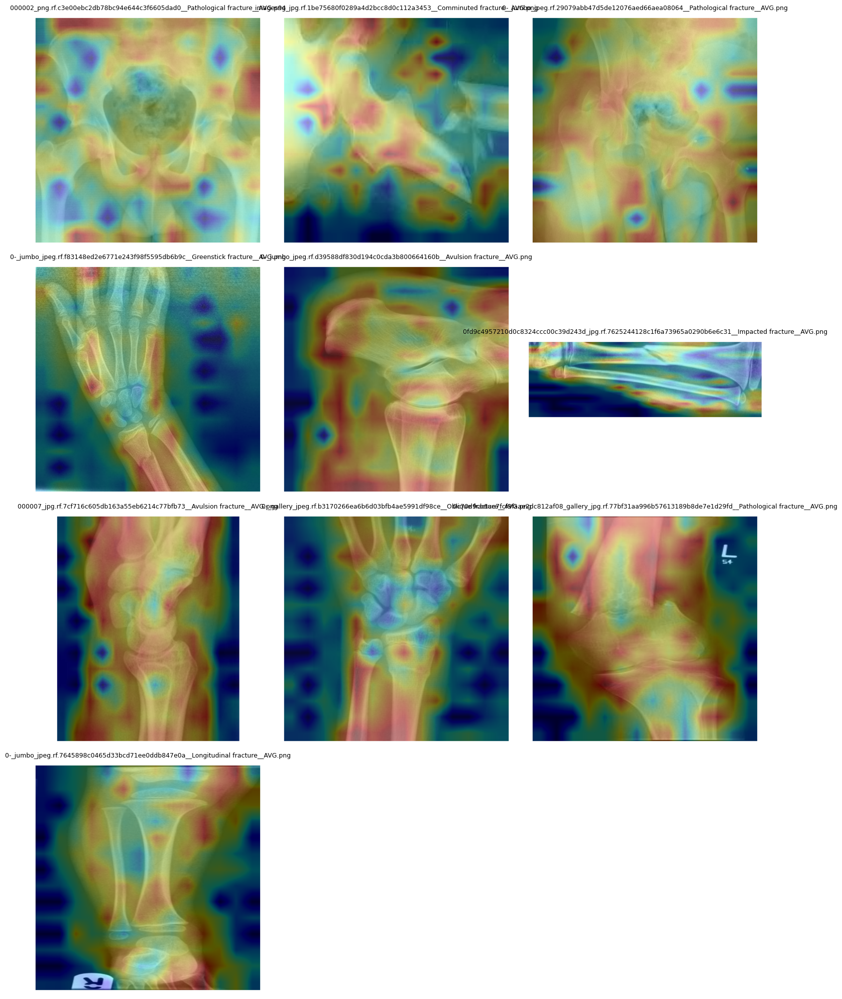

In [41]:
# ==== Prompt Ablation + Averaged LeGrad (drop-in for OpenCLIP) ====
# Requires: pip install legrad open_clip_torch

from legrad import LeWrapper, LePreprocess
import torch, torch.nn.functional as F
from PIL import Image
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import math, os

# --- 1) Wrap model for LeGrad + high-res viz preprocess ---

# ✅ Robust helper for OpenCLIP ViT sizes (handles tuples)
def make_viz_preprocess(model, preprocess):
    vis = getattr(model, "visual", None)
    img_sz = getattr(vis, "image_size", 224)
    if isinstance(img_sz, (tuple, list)):
        # OpenCLIP uses square inputs; take height
        img_sz = int(img_sz[0])
    else:
        img_sz = int(img_sz)

    patch = getattr(vis, "patch_size", 16)
    if isinstance(patch, (tuple, list)):
        patch = int(patch[0])
    else:
        patch = int(patch)

    # sanity: ViT expects image size divisible by patch size
    if img_sz % patch != 0:
        raise ValueError(f"image_size {img_sz} not divisible by patch_size {patch}")

    # Use native size to avoid pos-embed resampling
    try:
        return LePreprocess(preprocess=preprocess, image_size=img_sz)
    except Exception as e:
        # Fallback: use the original preprocess (no extra resize)
        print(f"[warn] LePreprocess failed ({e}); falling back to original preprocess.")
        return preprocess

le_model = LeWrapper(model)
viz_preprocess = make_viz_preprocess(model, preprocess)

# --- 2) Prompt templates to compare ---
TEMPLATES = [
    "a picture of {label}",
    "an X-ray of {label}",
    "a radiograph of {label}",
]
TEMPLATE_TAGS = ["picture", "xray", "radiograph"]  # short names for filenames

# --- 3) Build text embeddings for each template ---
tokenizer = open_clip.get_tokenizer(model_name=MODEL_NAME)

@torch.no_grad()
def build_text_embeds(templates, class_names):
    # returns: dict[tag] -> [C, d] L2-normalized embeddings
    out = {}
    for tmpl, tag in zip(templates, TEMPLATE_TAGS):
        prompts = [tmpl.format(label=c.replace("_", " ")) for c in class_names]
        text_tok = tokenizer(prompts).to(device)
        feats = le_model.encode_text(text_tok)           # [C, d]
        out[tag] = F.normalize(feats, dim=-1)            # cosine space
    return out

text_embeds = build_text_embeds(TEMPLATES, classes)  # dict[tag] -> [C, d]

# --- 4) Utilities: predict with linear probe, save overlay, normalize ---
@torch.no_grad()
def predict_idx_linearprobe(pil_img):
    xb = preprocess(pil_img).unsqueeze(0).to(device)
    feats = model.encode_image(xb)              # [1, d] (already L2-normalized)
    logits = head(feats)                        # [1, C]
    return int(logits.argmax(-1).item())

def save_overlay(pil_img, heat, out_path, alpha=0.35):
    # heat can be torch or np; normalize to [0,1] and fit to image
    if hasattr(heat, "detach"):
        h = heat.detach().float().cpu().numpy()
    else:
        h = np.asarray(heat, dtype=np.float32)
    while h.ndim > 2:  # squeeze [1,1,H,W]/[1,H,W] -> [H,W]
        h = h[0]
    h = h - h.min()
    h = h / (h.max() + 1e-8)

    W, H = pil_img.size
    hm = Image.fromarray((h * 255).astype(np.uint8)).resize((W, H), Image.BILINEAR)

    plt.figure(figsize=(6,6))
    plt.imshow(pil_img)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off"); plt.tight_layout()
    out_path.parent.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=150, bbox_inches="tight"); plt.close()

# --- 5) Choose the first test image per class (deterministic) ---
per_class_first = {}
for p, y in sorted(test_files, key=lambda t: t[0].as_posix().lower()):
    cname = id2label[y]
    if cname not in per_class_first:
        per_class_first[cname] = p

print(f"Classes with a first test image: {len(per_class_first)} / {len(classes)}")

# --- 6) Run: per-template LeGrad + averaged map ---
OUT_DIR = Path("./openclip_prompt_ablation_legrad"); OUT_DIR.mkdir(parents=True, exist_ok=True)
SAVE_PER_TEMPLATE = True  # set False if you only want the averaged overlay

def _to_np01(x):
    # helper: ensure heatmap is np.float32 in [0,1]
    if hasattr(x, "detach"):
        a = x.detach().float().cpu().numpy()
    else:
        a = np.asarray(x, dtype=np.float32)
    while a.ndim > 2:
        a = a[0]
    a = a - a.min()
    a = a / (a.max() + 1e-8)
    return a

outputs = []
for cls_name, img_path in per_class_first.items():
    raw = Image.open(img_path).convert("RGB")
    pred_idx = predict_idx_linearprobe(raw)                     # which class we're explaining
    pred_label = id2label.get(pred_idx, f"class_{pred_idx}")

    # Compute per-template LeGrad maps (all with the same image)
    img_in = viz_preprocess(raw).unsqueeze(0).to(device)
    img_in.requires_grad_(True)

    per_tmpl_maps = []
    for tag in TEMPLATE_TAGS:
        heat = le_model.compute_legrad_clip(
            image=img_in,
            text_embedding=text_embeds[tag][pred_idx:pred_idx+1]   # 1 x d
        )
        per_tmpl_maps.append(_to_np01(heat))

        if SAVE_PER_TEMPLATE:
            out_png = OUT_DIR / f"{Path(img_path).stem}__{pred_label}__{tag}.png"
            save_overlay(raw, heat, out_png, alpha=0.35)

    # Average the normalized maps
    avg_heat = np.mean(np.stack(per_tmpl_maps, axis=0), axis=0)
    out_avg = OUT_DIR / f"{Path(img_path).stem}__{pred_label}__AVG.png"
    save_overlay(raw, avg_heat, out_avg, alpha=0.35)
    outputs.append((out_avg, f"{cls_name} → {pred_label} (avg over {len(TEMPLATES)} prompts)"))

print(f"Saved overlays to: {OUT_DIR}")

# --- 7) Optional: display a grid of averaged maps ---
cols = 3
rows = math.ceil(len(outputs) / cols) if outputs else 1
plt.figure(figsize=(5*cols, 5*rows))
for i, (op, lbl) in enumerate(outputs, start=1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(Path(op).name, fontsize=9)
    ax.set_xlabel(lbl, fontsize=8)
    ax.axis("off")
plt.tight_layout(); plt.show()


Classes with a first test image: 10 / 10


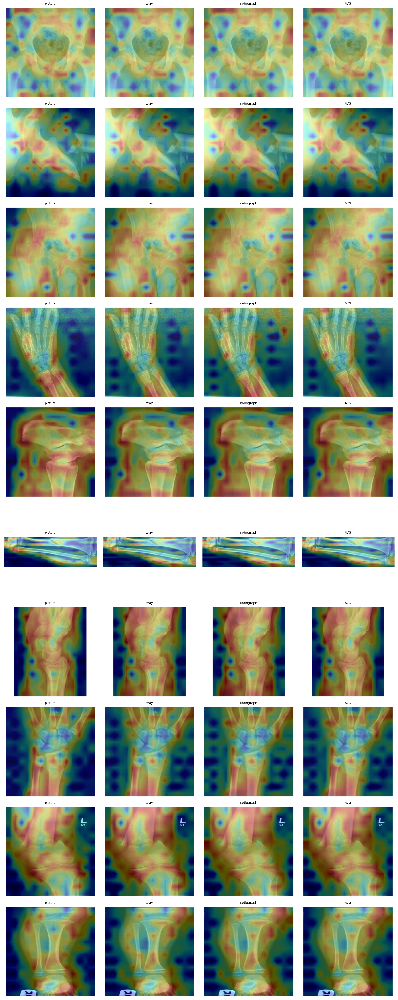

In [42]:
# ========= Per-template LeGrad overlays + side-by-side display =========
from pathlib import Path
from typing import Dict, List, Tuple
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import torch
import math
import os

# Where to save overlays
OUT_DIR = Path("./openclip_prompt_templates_legrad")
OUT_DIR.mkdir(parents=True, exist_ok=True)

SAVE_PER_TEMPLATE = True       # set False if you only want display (no files)
INCLUDE_AVG_COLUMN = True      # add an averaged column at the end
MAX_ROWS = None                # None = all classes; or set an int to limit display rows

# Build {class_name: first_test_image_path} deterministically
per_class_first: Dict[str, Path] = {}
for p, y in sorted(test_files, key=lambda t: t[0].as_posix().lower()):
    cname = id2label[y]
    if cname not in per_class_first:
        per_class_first[cname] = p
print(f"Classes with a first test image: {len(per_class_first)} / {len(classes)}")

def _to_np01(x):
    # Convert any torch/np heatmap to np.float32 [H,W] in [0,1]
    if hasattr(x, "detach"):
        a = x.detach().float().cpu().numpy()
    else:
        a = np.asarray(x, dtype=np.float32)
    while a.ndim > 2:  # squeeze [1,1,H,W]/[1,H,W] -> [H,W]
        a = a[0]
    a = a - a.min()
    a = a / (a.max() + 1e-8)
    return a

def _save_overlay(raw_pil: Image.Image, heat_np01: np.ndarray, out_path: Path, alpha: float = 0.35):
    # heat_np01 should be [H,W] in [0,1]
    from PIL import Image as PILImage
    W, H = raw_pil.size
    hm = PILImage.fromarray((heat_np01 * 255).astype(np.uint8)).resize((W, H), PILImage.BILINEAR)

    plt.figure(figsize=(6, 6))
    plt.imshow(raw_pil)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off"); plt.tight_layout()
    out_path.parent.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=150, bbox_inches="tight")
    plt.close()

@torch.no_grad()
def predict_idx_linearprobe(pil_img: Image.Image) -> int:
    xb = preprocess(pil_img).unsqueeze(0).to(device)
    feats = model.encode_image(xb)         # [1, d] (OpenCLIP already L2-normalized)
    logits = head(feats)                   # [1, C]
    return int(logits.argmax(-1).item())

# ---- Compute, save, and collect overlays ----
col_tags = list(TEMPLATE_TAGS)
if INCLUDE_AVG_COLUMN:
    col_tags = col_tags + ["AVG"]

rows_data: List[Tuple[str, Dict[str, Path], str]] = []  # (class_name, {tag: path}, label_shown)

for cls_name, img_path in per_class_first.items():
    raw = Image.open(img_path).convert("RGB")
    pred_idx = predict_idx_linearprobe(raw)
    pred_label = id2label.get(pred_idx, f"class_{pred_idx}")

    # Prepare image tensor for LeGrad (native size via viz_preprocess)
    img_in = viz_preprocess(raw).unsqueeze(0).to(device)
    img_in.requires_grad_(True)

    # Per-template LeGrad
    per_tmpl_np = {}
    per_tmpl_paths = {}

    for tag in TEMPLATE_TAGS:
        heat = le_model.compute_legrad_clip(
            image=img_in,
            text_embedding=text_embeds[tag][pred_idx:pred_idx+1]  # [1, d]
        )
        heat_np = _to_np01(heat)
        per_tmpl_np[tag] = heat_np

        if SAVE_PER_TEMPLATE:
            out_t = OUT_DIR / f"{Path(img_path).stem}__{pred_label}__{tag}.png"
            _save_overlay(raw, heat_np, out_t, alpha=0.35)
            per_tmpl_paths[tag] = out_t

    # Optional AVG across templates
    if INCLUDE_AVG_COLUMN:
        avg_np = np.mean(np.stack([per_tmpl_np[tag] for tag in TEMPLATE_TAGS], axis=0), axis=0)
        out_avg = OUT_DIR / f"{Path(img_path).stem}__{pred_label}__AVG.png"
        _save_overlay(raw, avg_np, out_avg, alpha=0.35)
        per_tmpl_paths["AVG"] = out_avg

    rows_data.append((cls_name, per_tmpl_paths, pred_label))

# ---- Display grid: rows = classes, cols = templates (+avg) ----
if MAX_ROWS is not None:
    rows_data = rows_data[:MAX_ROWS]

n_rows = max(1, len(rows_data))
n_cols = len(col_tags)

plt.figure(figsize=(4.5*n_cols, 4.5*n_rows))
for r, (cls_name, paths_map, pred_label) in enumerate(rows_data, start=1):
    for c, tag in enumerate(col_tags, start=1):
        ax = plt.subplot(n_rows, n_cols, (r-1)*n_cols + c)
        path = paths_map.get(tag)
        if path is not None and path.exists():
            ax.imshow(Image.open(path).convert("RGB"))
            ttl = f"{tag}"
        else:
            # Fallback: if file wasn’t saved (SAVE_PER_TEMPLATE=False), render live
            # using the cached np heatmaps (if you retained them) – here we just show raw.
            ax.imshow(raw)
            ttl = f"{tag} (no file)"
        if c == 1:
            ax.set_ylabel(f"{cls_name}\n→ {pred_label}", fontsize=10)
        ax.set_title(ttl, fontsize=10)
        ax.axis("off")
plt.tight_layout()
plt.show()


## Linear Probe + Full Eval + LeGrad Overlays (ViT backbone)

Detected classes: ['Avulsion fracture', 'Comminuted fracture', 'Fracture Dislocation', 'Greenstick fracture', 'Hairline Fracture', 'Impacted fracture', 'Longitudinal fracture', 'Oblique fracture', 'Pathological fracture', 'Spiral Fracture']
[Eval setup] Train imgs: 989 | Test imgs: 140


Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


[LinearProbe] Epoch 01 | train_loss=2.2630 acc=0.193 | test@1=0.264 test@3=0.514
[LinearProbe] Epoch 02 | train_loss=2.0092 acc=0.313 | test@1=0.279 test@3=0.579
[LinearProbe] Epoch 03 | train_loss=1.8682 acc=0.371 | test@1=0.314 test@3=0.643
[LinearProbe] Epoch 04 | train_loss=1.7255 acc=0.450 | test@1=0.314 test@3=0.600
[LinearProbe] Epoch 05 | train_loss=1.6425 acc=0.495 | test@1=0.293 test@3=0.671
[LinearProbe] Epoch 06 | train_loss=1.6226 acc=0.467 | test@1=0.314 test@3=0.643
[LinearProbe] Epoch 07 | train_loss=1.5172 acc=0.545 | test@1=0.329 test@3=0.643
[LinearProbe] Epoch 08 | train_loss=1.4690 acc=0.552 | test@1=0.386 test@3=0.707
[LinearProbe] Epoch 09 | train_loss=1.4105 acc=0.573 | test@1=0.321 test@3=0.629
[LinearProbe] Epoch 10 | train_loss=1.3555 acc=0.599 | test@1=0.379 test@3=0.700

[LinearProbe] Final Test top1=0.379 top3=0.700
Per-class accuracy:
  - Avulsion fracture        acc=0.857 (n=14)
  - Comminuted fracture      acc=0.643 (n=14)
  - Fracture Dislocation     a

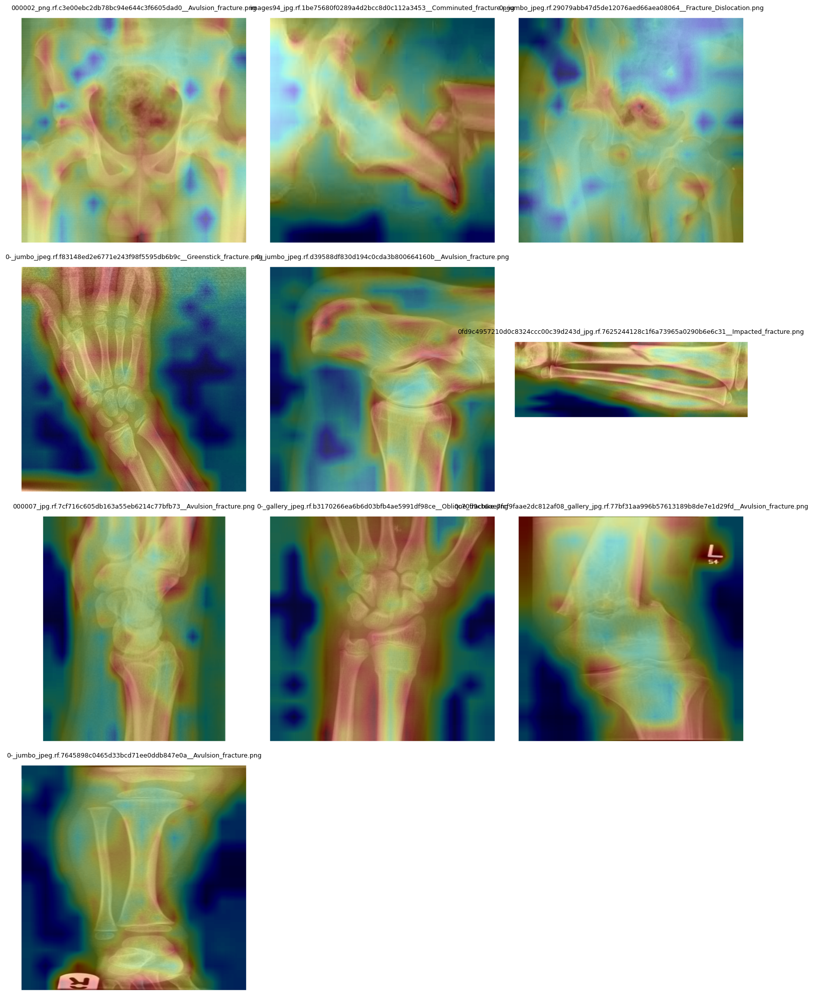

In [33]:
# ==== Linear Probe + Full Eval + LeGrad Overlays (ViT backbone) ====
# pip install -q transformers torchvision pillow matplotlib

import os, math, random
from pathlib import Path
from collections import defaultdict
from typing import List, Tuple, Dict

import torch, torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
from transformers import AutoImageProcessor, ViTModel
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# ----------------------------
# Config
# ----------------------------
device = "cuda" if torch.cuda.is_available() else "cpu"
ROOT = Path("/content/data/bone-break/Bone Break Classification/Bone Break Classification")
OUT_DIR = Path("/content/linearprobe_vit_legrad_outputs"); OUT_DIR.mkdir(parents=True, exist_ok=True)

MODEL_ID = "google/vit-base-patch16-224"
BATCH = 32
EPOCHS = 10
LR = 1e-3
WEIGHT_DECAY = 0.01
TRAIN_SIZE = 224        # must match ViT default to avoid size mismatch
IMAGE_SIZE = 448        # for LeGrad overlay crispness
ALPHA = 0.35
SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)
use_amp = (device == "cuda")

IMG_EXTS = {".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".gif"}

# ----------------------------
# Dataset discovery (expects Class/Train + Class/Test)
# ----------------------------
def list_class_dirs(root: Path) -> List[Path]:
    return sorted([d for d in root.iterdir() if d.is_dir()], key=lambda p: p.name.lower())

def first_existing(*paths: Path):
    for p in paths:
        if p is not None and p.exists():
            return p
    return None

def iter_images(d: Path):
    return [p for p in d.rglob("*") if p.is_file() and p.suffix.lower() in IMG_EXTS]

class_dirs = list_class_dirs(ROOT)
classes = [d.name for d in class_dirs]
num_labels = len(classes)
label2id = {c:i for i,c in enumerate(classes)}
id2label = {i:c for c,i in label2id.items()}
print("Detected classes:", classes)

train_files: List[Tuple[Path,int]] = []
test_files:  List[Tuple[Path,int]] = []
for cdir in class_dirs:
    train_dir = first_existing(cdir/"Train", cdir/"train")
    test_dir  = first_existing(cdir/"Test",  cdir/"test", cdir)  # fallback to class root if no Test/
    if train_dir: train_files += [(p, label2id[cdir.name]) for p in iter_images(train_dir)]
    if test_dir:  test_files  += [(p, label2id[cdir.name]) for p in iter_images(test_dir)]
print(f"[Eval setup] Train imgs: {len(train_files)} | Test imgs: {len(test_files)}")

# ----------------------------
# Datasets & transforms (keep simple for linear probe)
# ----------------------------
processor = AutoImageProcessor.from_pretrained(MODEL_ID, use_fast=True)
mean = getattr(processor, "image_mean", [0.5, 0.5, 0.5])
std  = getattr(processor, "image_std",  [0.5, 0.5, 0.5])

eval_tfms = T.Compose([
    T.Resize(int(TRAIN_SIZE * 1.10)),
    T.CenterCrop(TRAIN_SIZE),
    T.ToTensor(),
    T.Normalize(mean=mean, std=std),
])

class ImgDataset(Dataset):
    def __init__(self, pairs, transform):
        self.pairs, self.transform = pairs, transform
    def __len__(self): return len(self.pairs)
    def __getitem__(self, i):
        path, y = self.pairs[i]
        img = Image.open(path).convert("RGB")
        x = self.transform(img)
        return x, y

train_loader = DataLoader(ImgDataset(train_files, eval_tfms), batch_size=BATCH, shuffle=True,
                          num_workers=2, pin_memory=use_amp)
test_loader  = DataLoader(ImgDataset(test_files,  eval_tfms), batch_size=BATCH, shuffle=False,
                          num_workers=2, pin_memory=use_amp)

# ----------------------------
# Frozen ViT backbone + linear head
# ----------------------------
from transformers import ViTModel

# Reload with eager attention:
vit = ViTModel.from_pretrained(
    MODEL_ID,
    attn_implementation="eager",   # <-- key line
).to(device).eval()

for p in vit.parameters():
    p.requires_grad = False
feat_dim = vit.config.hidden_size  # 768 for ViT-B/16

head = nn.Linear(feat_dim, num_labels).to(device)
optimizer = torch.optim.AdamW(head.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
scaler = torch.amp.GradScaler(enabled=use_amp)

@torch.no_grad()
def extract_cls(vit_model, x):
    out = vit_model(x)           # returns BaseModelOutputWithPooling (return_dict=True by default)
    return out.last_hidden_state[:, 0, :]  # CLS token [B, D]

def run_epoch_linear(loader, train: bool):
    head.train(train)
    total=correct=0; loss_sum=0.0
    for xb, yb in loader:
        xb, yb = xb.to(device, non_blocking=use_amp), yb.to(device, non_blocking=use_amp)
        if train: optimizer.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type="cuda", dtype=torch.float16, enabled=use_amp):
            with torch.no_grad():  # backbone frozen
                feats = extract_cls(vit, xb)
            logits = head(feats)
            loss = F.cross_entropy(logits, yb)
        if train:
            scaler.scale(loss).backward(); scaler.step(optimizer); scaler.update()
        pred = logits.argmax(-1)
        correct += (pred == yb).sum().item()
        total += yb.numel()
        loss_sum += float(loss) * yb.numel()
    return loss_sum/max(total,1), correct/max(total,1)

@torch.no_grad()
def evaluate_full(loader):
    head.eval()
    total=correct=0; top3=0
    cm = torch.zeros(num_labels, num_labels, dtype=torch.long)
    per_cls_hits = defaultdict(int); per_cls_cnt = defaultdict(int)

    for xb, yb in loader:
        xb, yb = xb.to(device), yb.to(device)
        feats = extract_cls(vit, xb)
        logits = head(feats)
        probs = logits.softmax(-1)
        pred = probs.argmax(-1)

        total += yb.numel()
        correct += (pred == yb).sum().item()

        topk = probs.topk(k=min(3, num_labels), dim=-1).indices
        top3 += (topk == yb.unsqueeze(1)).any(dim=1).sum().item()

        for t, p in zip(yb.view(-1), pred.view(-1)):
            cm[t.long(), p.long()] += 1
            per_cls_cnt[int(t)] += 1
            if t == p: per_cls_hits[int(t)] += 1

    top1 = correct / max(total,1)
    top3_acc = top3 / max(total,1)
    per_class = [(id2label[i], f"{(per_cls_hits[i]/max(per_cls_cnt[i],1)):.3f}", per_cls_cnt[i])
                 for i in range(num_labels)]
    return top1, top3_acc, cm, per_class

# ----------------------------
# Train linear head + quick test probe each epoch
# ----------------------------
for epoch in range(1, EPOCHS+1):
    tr_loss, tr_acc = run_epoch_linear(train_loader, train=True)
    te_top1, te_top3, _, _ = evaluate_full(test_loader)
    print(f"[LinearProbe] Epoch {epoch:02d} | train_loss={tr_loss:.4f} acc={tr_acc:.3f} "
          f"| test@1={te_top1:.3f} test@3={te_top3:.3f}")

# Final eval
top1, top3, cm, per_class = evaluate_full(test_loader)
print(f"\n[LinearProbe] Final Test top1={top1:.3f} top3={top3:.3f}")
print("Per-class accuracy:")
for name, acc, n in per_class:
    print(f"  - {name:<24} acc={acc} (n={n})")
print("\n[Test] Confusion matrix (rows=true, cols=pred):")
print(cm.cpu().numpy())

# ----------------------------
# LeGrad overlays from frozen ViT + linear head
# ----------------------------
# Make ViT return attentions & dict outputs for LeGrad
vit.config.output_attentions = True
vit.config.return_dict = True
vit.eval(); head.eval()

def save_overlay(pil_img: Image.Image, heat: np.ndarray, out_path: Path, alpha: float = ALPHA):
    W, H = pil_img.size
    hm = Image.fromarray((heat * 255).astype(np.uint8)).resize((W, H), Image.BILINEAR)
    plt.figure(figsize=(6, 6))
    plt.imshow(pil_img)
    plt.imshow(hm, cmap="jet", alpha=alpha)
    plt.axis("off"); plt.tight_layout()
    out_path.parent.mkdir(parents=True, exist_ok=True)
    plt.savefig(out_path, dpi=150, bbox_inches="tight"); plt.close()

def compute_legrad_vit_linearprobe(
    image_pil: Image.Image,
    vit_model: ViTModel,
    head: nn.Module,
    processor,
    device,
    image_size: int = IMAGE_SIZE,
    target_index: int | None = None,
) -> Tuple[np.ndarray, int]:
    # high-res visual input; processor will resize to 224 for ViT
    vis_img = image_pil.resize((image_size, image_size), Image.BILINEAR)
    x = processor(images=vis_img, return_tensors="pt")["pixel_values"].to(device)
    x.requires_grad_(True)

    # forward WITH attentions (no torch.no_grad)
    out = vit_model(x, output_attentions=True, return_dict=True)
    cls = out.last_hidden_state[:, 0, :]   # [1, D]
    logits = head(cls)                      # [1, C]
    if target_index is None:
        target_index = int(logits.argmax(-1).item())

    attentions = out.attentions
    if attentions is None: raise RuntimeError("No attentions returned.")

    for a in attentions: a.retain_grad()

    loss = logits[0, target_index]
    head.zero_grad(set_to_none=True); vit_model.zero_grad(set_to_none=True)
    loss.backward(retain_graph=False)

    grads_per_layer = []
    for a in attentions:               # [1, heads, T, T]
        g = a.grad
        if g is None: continue
        g = F.relu(g).mean(dim=1)      # -> [1, T, T]
        grads_per_layer.append(g[0])   # -> [T, T]
    if not grads_per_layer:
        raise RuntimeError("No attention gradients captured.")

    G = torch.stack(grads_per_layer, dim=0).sum(dim=0)  # [T, T]
    G = G[1:, 1:]                                       # drop [CLS]
    patch_scores = F.relu(G.sum(dim=0))
    patch_scores = patch_scores / (patch_scores.max() + 1e-8)

    side = int(np.sqrt(patch_scores.numel()))
    heat = patch_scores.reshape(side, side).detach().cpu().numpy().astype(np.float32)
    heat_img = Image.fromarray((heat * 255).astype(np.uint8)).resize((image_size, image_size), Image.BILINEAR)
    heat = np.array(heat_img, dtype=np.float32) / 255.0
    return heat, target_index

# choose first test image per class (deterministic)
per_class_first: Dict[str, Path] = {}
for p, y in sorted(test_files, key=lambda t: t[0].as_posix().lower()):
    cname = id2label[y]
    if cname not in per_class_first:
        per_class_first[cname] = p
print(f"Classes with a first test image: {len(per_class_first)} / {num_labels}")

# run and save overlays
outputs: List[Tuple[Path, str]] = []
for cls_name, img_path in per_class_first.items():
    raw = Image.open(img_path).convert("RGB")
    heat, cls_idx = compute_legrad_vit_linearprobe(
        raw, vit_model=vit, head=head, processor=processor, device=device, image_size=IMAGE_SIZE
    )
    label = id2label.get(cls_idx, f"class_{cls_idx}")
    out_png = OUT_DIR / f"{Path(img_path).stem}__{label.replace(' ', '_')}.png"
    save_overlay(raw, heat, out_png, alpha=ALPHA)
    outputs.append((out_png, f"{cls_name} → {label}"))

print(f"Saved {len(outputs)} overlays to: {OUT_DIR}")

# display grid
cols = 3
rows = math.ceil(len(outputs) / cols) if outputs else 1
plt.figure(figsize=(5*cols, 5*rows))
for i, (op, lbl) in enumerate(outputs, start=1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(Path(op).name, fontsize=9)
    ax.set_xlabel(lbl, fontsize=8)
    ax.axis("off")
plt.tight_layout(); plt.show()


## Improve LeGrad Overlay

In [45]:
!pip -q install opencv-python-headless

In [46]:
import torch, numpy as np, cv2
import torch.nn.functional as F
from PIL import Image
from torchvision import transforms as T
from pathlib import Path
import matplotlib.pyplot as plt
import math, os

# ----- High-res CLIP-like transform (keeps CLIP norm) -----
def make_clip_transform(size=512):
    return T.Compose([
        T.Resize((size, size), interpolation=T.InterpolationMode.BICUBIC),
        T.ToTensor(),
        T.Normalize(mean=(0.48145466, 0.4578275, 0.40821073),
                    std =(0.26862954, 0.26130258, 0.27577711)),
    ])

# ----- CLAHE (radiograph-friendly) on PIL -> PIL -----
def apply_clahe_pil(pil_img, clip_limit=2.0, tile_grid_size=(8,8)):
    img = np.array(pil_img.convert("RGB"))
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    L, A, B = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    L2 = clahe.apply(L)
    lab2 = cv2.merge([L2, A, B])
    out = cv2.cvtColor(lab2, cv2.COLOR_LAB2RGB)
    return Image.fromarray(out)

# ----- Simple text/watermark mask: zero out bottom strip -----
def mask_text_strip(pil_img, bottom_ratio=0.12):
    w, h = pil_img.size
    m = np.ones((h, w), dtype=np.float32)
    cut = int(h * (1 - bottom_ratio))
    m[cut:, :] = 0.0
    return m  # [H, W] in {0,1}

# ----- TTA heatmap averaging -----
def compute_legrad_tta(
    raw_pil: Image.Image,
    class_idx: int,
    text_emb: torch.Tensor,
    sizes=(448, 512),
    hflip=False,
    bottom_mask_ratio=0.12
):
    """
    Returns averaged heatmap (torch.FloatTensor [H,W] normalized 0..1 in raw size).
    """
    device = next(text_emb.parameters(), text_emb).device if hasattr(text_emb, "parameters") else text_emb.device

    # Build bottom text mask once (same for all TTA variants)
    H0, W0 = raw_pil.height, raw_pil.width
    text_mask = mask_text_strip(raw_pil, bottom_ratio=bottom_mask_ratio)  # [H0,W0] in {0,1}

    heats = []
    for sz in sizes:
        tf = make_clip_transform(sz)
        # base
        x = tf(raw_pil).unsqueeze(0).to(device).requires_grad_(True)
        heat = leclip.compute_legrad_clip(image=x, text_embedding=text_emb[class_idx:class_idx+1])
        heat = heat.detach().cpu().float().squeeze()
        heat = (heat - heat.min()) / (heat.max() - heat.min() + 1e-8)
        heat_img = Image.fromarray((heat*255).numpy().astype(np.uint8)).resize((W0, H0), Image.BILINEAR)
        heat = np.asarray(heat_img).astype(np.float32)/255.0
        # apply mask (remove bottom strip influence)
        heat *= text_mask
        heats.append(heat)

        if hflip:
            raw_flip = raw_pil.transpose(Image.Transpose.FLIP_LEFT_RIGHT)
            x2 = tf(raw_flip).unsqueeze(0).to(device).requires_grad_(True)
            heat2 = leclip.compute_legrad_clip(image=x2, text_embedding=text_emb[class_idx:class_idx+1])
            heat2 = heat2.detach().cpu().float().squeeze()
            heat2 = (heat2 - heat2.min()) / (heat2.max() - heat2.min() + 1e-8)
            heat2 = Image.fromarray((heat2*255).numpy().astype(np.uint8)).resize((W0, H0), Image.BILINEAR)
            heat2 = np.asarray(heat2).astype(np.float32)/255.0
            heat2 = np.fliplr(heat2)  # unflip back
            heat2 *= text_mask
            heats.append(heat2)

        del x
        torch.cuda.empty_cache()

    H = np.mean(np.stack(heats, 0), axis=0)
    H = (H - H.min()) / (H.max() - H.min() + 1e-8)
    return torch.from_numpy(H)  # [H0,W0]

In [47]:
def overlay_and_show(raw_pil, heat, title="", alpha=0.35, save_to=None):
    H = heat.detach().cpu().numpy().astype(np.float32)
    H = (H - H.min()) / (H.max() - H.min() + 1e-8)
    W, H0 = raw_pil.size
    hm = Image.fromarray((H*255).astype(np.uint8))
    hm = hm.resize((W, H0), Image.BILINEAR)

    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1); plt.imshow(raw_pil); plt.title("Raw"); plt.axis("off")
    plt.subplot(1,2,2);
    plt.imshow(raw_pil);
    plt.imshow(hm, cmap="jet", alpha=alpha);
    plt.title(title); plt.axis("off")
    plt.tight_layout()
    if save_to:
        plt.savefig(save_to, dpi=150, bbox_inches="tight")
        plt.close()
    else:
        plt.show()

# ---- Blur-based sanity checks on logits (with trained prompts) ----
@torch.no_grad()
def logit_sanity_checks(raw_pil, text_emb, target_idx, blur_px=25):
    # base logits @512
    tf = make_clip_transform(512)
    base = tf(raw_pil).unsqueeze(0).to(device)
    img_feat = F.normalize(clip_model.encode_image(base), dim=-1)
    logits = (img_feat @ text_emb.T).float().squeeze()
    base_logit = logits[target_idx].item()

    # make ROI mask from heat (top 20% mass)
    heat = compute_legrad_tta(raw_pil, target_idx, text_emb, sizes=(512,), hflip=False)
    h = heat.numpy()
    thr = np.quantile(h, 0.8)
    roi = (h >= thr).astype(np.float32)

    # blur helpers
    def blur_img(pil, mask):
        img = np.array(pil.convert("RGB"))
        k = blur_px | 1  # odd
        bl = cv2.GaussianBlur(img, (k,k), 0)
        m3 = np.stack([mask]*3, axis=-1)
        out = (img*(1-m3) + bl*m3).astype(np.uint8)
        return Image.fromarray(out)

    # blur ROI
    raw_roi_blur = blur_img(raw_pil, roi)
    x = tf(raw_roi_blur).unsqueeze(0).to(device)
    l_roi = (F.normalize(clip_model.encode_image(x), dim=-1) @ text_emb.T).float().squeeze()[target_idx].item()

    # blur background
    raw_bg_blur = blur_img(raw_pil, 1-roi)
    x = tf(raw_bg_blur).unsqueeze(0).to(device)
    l_bg  = (F.normalize(clip_model.encode_image(x), dim=-1) @ text_emb.T).float().squeeze()[target_idx].item()

    return dict(base=base_logit, blur_roi=l_roi, blur_bg=l_bg)


In [48]:
def legrad_clip_tta_visualize(img_path, out_dir="/content/legrad_outputs_clip_tta",
                              sizes=(448,512), hflip=True, use_clahe=True, bottom_mask_ratio=0.12):
    os.makedirs(out_dir, exist_ok=True)

    # Get trained (or baseline) text embeddings
    try:
        text_emb = get_trained_text_emb()  # [C,d], normalized
    except Exception:
        # Fallback to baseline prompts if prompt_learner not present
        tokenizer = open_clip.get_tokenizer("ViT-B-16")
        prompts = [f"an X-ray of {c}" for c in classes]
        with torch.no_grad():
            text_tok = tokenizer(prompts).to(device)
            text_emb = F.normalize(clip_model.encode_text(text_tok), dim=-1)

    # Load & optional CLAHE
    raw = Image.open(img_path).convert("RGB")
    if use_clahe:
        raw = apply_clahe_pil(raw)

    # choose class with trained prompts at 512
    tf = make_clip_transform(512)
    with torch.no_grad():
        x = tf(raw).unsqueeze(0).to(device)
        img_feat = F.normalize(clip_model.encode_image(x), dim=-1)
        idx = (img_feat @ text_emb.T).argmax(-1).item()
        pred_name = classes[idx]

    # TTA heatmap
    heat = compute_legrad_tta(raw, idx, text_emb,
                              sizes=sizes, hflip=hflip, bottom_mask_ratio=bottom_mask_ratio)

    # Save & show
    out_png = str(Path(out_dir)/f"{Path(img_path).stem}__{pred_name}__tta.png")
    overlay_and_show(raw, heat, title=f"LeGrad (TTA) — {pred_name}", alpha=0.35, save_to=out_png)

    # Sanity checks
    stats = logit_sanity_checks(raw, text_emb, idx, blur_px=25)
    print(f"[logits] base={stats['base']:.3f} | blur_roi={stats['blur_roi']:.3f} | blur_bg={stats['blur_bg']:.3f} "
          f"→ Δroi={stats['base']-stats['blur_roi']:.3f}, Δbg={stats['base']-stats['blur_bg']:.3f}")

    return out_png, pred_name, stats


In [52]:
# Collect a few test images and visualize
ROOT = Path("/content/data/bone-break/Bone Break Classification/Bone Break Classification")
IMG_EXTS = {".jpg",".jpeg",".png",".bmp",".tif",".tiff",".gif"}

def list_test_images(root: Path):
    out = []
    for cdir in sorted([d for d in root.iterdir() if d.is_dir()], key=lambda p: p.name.lower()):
        tdir = None
        for n in ("Test","test"):
            cand = cdir/n
            if cand.is_dir(): tdir = cand; break
        tdir = tdir or cdir
        out += [p for p in tdir.rglob("*") if p.is_file() and p.suffix.lower() in IMG_EXTS]
    return out

test_imgs = list_test_images(ROOT)
picked = np.random.choice(test_imgs, size=min(6, len(test_imgs)), replace=False)

outs = []
for p in picked:
    out_png, pred, stats = legrad_clip_tta_visualize(str(p),
                                                     sizes=(448,512),
                                                     hflip=True,
                                                     use_clahe=True,
                                                     bottom_mask_ratio=0.12)
    outs.append(out_png)

# Show just the overlays in a grid
cols = 3
rows = math.ceil(len(outs)/cols)
plt.figure(figsize=(5*cols, 5*rows))
for i, op in enumerate(outs, 1):
    ax = plt.subplot(rows, cols, i)
    ax.imshow(Image.open(op).convert("RGB"))
    ax.set_title(Path(op).name, fontsize=9)
    ax.axis("off")
plt.tight_layout(); plt.show()

RuntimeError: cannot reshape tensor of 0 elements into shape [1, 0, 0, -1] because the unspecified dimension size -1 can be any value and is ambiguous

## GPU Memory

In [43]:
import torch, gc
def gpu_mem():
    a = torch.cuda.memory_allocated() / 1024**2
    r = torch.cuda.memory_reserved() / 1024**2
    print(f"allocated={a:.1f} MiB | reserved={r:.1f} MiB")
gpu_mem()

allocated=2433.1 MiB | reserved=3066.0 MiB


In [35]:
import gc, torch

# Offload to CPU if you still need objects later; otherwise delete.
try:
    clip_model.to("cpu")
except: pass
for name in ["leclip", "clip_model", "clf", "text_emb", "text_tok", "tokenizer", "preprocess"]:
    if name in globals():
        try:
            obj = globals()[name]
            if hasattr(obj, "to"): obj.to("cpu")
            del globals()[name]
        except: pass

# Delete old optimizers / schedulers
for name in ["opt", "optimizer", "scheduler", "scaler"]:
    if name in globals():
        try: del globals()[name]
        except: pass

gc.collect()
torch.cuda.empty_cache()
gpu_mem()


allocated=984.0 MiB | reserved=1332.0 MiB
